In [1]:
import multiprocessing
import os
import sys

In [2]:
import numpy as np
import pandas as pd
from pandarallel import pandarallel
pandarallel.initialize(progress_bar=True)
import cv2
import math
import random
import os
import shutil
import base64


#dicom image utility
import pydicom as dicom

#imblearn
from imblearn.under_sampling import RandomUnderSampler

#plotting
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from matplotlib.patches import Rectangle
import seaborn as sns
from IPython.core.display import HTML
from IPython.display import Markdown, display
import klib
import visualkeras
import graphviz

#metrics
from tqdm import tqdm
from sklearn import model_selection
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, make_scorer
from sklearn.metrics import roc_auc_score, precision_score, recall_score, f1_score
from sklearn.metrics import roc_curve, auc

#utils
import zipfile
from glob import glob
from tqdm import tqdm, tqdm_notebook

#sklearn
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.utils.class_weight import compute_class_weight
from sklearn.utils import resample,shuffle

#PCA
from sklearn.decomposition import PCA
from sklearn.svm import SVC


#Deep Learning
import keras
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.utils import plot_model
from tensorflow.keras import losses
from tensorflow.keras import optimizers
from tensorflow.keras import Sequential, Model, Input
from keras.layers import Input, Add, Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, GlobalMaxPooling2D, Dropout, Convolution2D
from keras.optimizers import SGD
from keras.models import load_model
import warnings
warnings.filterwarnings('ignore')
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping

from tensorflow.keras.utils import to_categorical
from keras.preprocessing.image import ImageDataGenerator
from keras.initializers import glorot_uniform

INFO: Pandarallel will run on 10 workers.
INFO: Pandarallel will use standard multiprocessing data transfer (pipe) to transfer data between the main process and workers.


In [3]:
#googlecolab / local run flag
googlecolab = False

In [4]:
#initalize base and data folder.
if googlecolab:
    from google.colab import drive
    drive.mount('/content/drive/')
    base_folder = '/content/drive/MyDrive/PneumoniaDetection'
else:
    base_folder = '.'

data_folder = base_folder + '/data'



## 1.)  Import the data
## 2.)  Map training and testing images to its classes
## 3.)  Map training and testing images to its annotations

In [5]:
def print_markdown(text, color=None):
    colorstr = "<span style='color:{}'>{}</span>".format(color, text)
    display(Markdown(colorstr))

In [6]:
class DatasetUtils():
    #extract all zip files
    def extractZipFile(self, src_file, dst_folder):
        print(f'Extracting {src_file}...')
        with zipfile.ZipFile(src_file) as zip_file:
            zip_file.extractall(dst_folder)
        print(f'Extracting {src_file}...Done!')
            
    #reads a csv file to a dataframe
    def read_csv(self, csv_file, na_values=None):
        return pd.read_csv(csv_file, na_values=na_values)
    
    #get first n samples from the dataframe
    def get_top_samples(self, df, n=5):
        return df.head(n)
    
    #get n random samples of a dataframe
    def get_random_samples(self, df, n=7):
        return df.sample(n)
    
    #get unique rows in a dataframe for a column
    def get_nunique_rows(self, df, col_name):
        return df[col_name].nunique()
    
    #print head and shape of any dataframe
    def display_head_shape(self, df):
        print(df.head())
        print(f'Shape = {df.shape}\n')
    
    #concat two dataframes on a column value
    def concat_dataframes(self, df1, df2, col_name):
        return pd.concat([df1, df2[col_name]], axis = 1)
    
    #merge two dataframes using a key
    def merge_dataframes(self, df1, df2, col_name):
        return pd.merge(df1, df2, on=col_name, how='left')
    
    #convert a column to int
    def convert_col_to_int(self, df, col_name):
        return df[col_name].astype('int')
    
    #sample and remove those items from the original dataframe
    def sample_and_remove(self, df, n, random_state=None):
        df_sample = df.sample(n=n, replace=False, random_state=random_state)
        df.drop(df_sample.index, inplace=True)
        return df_sample

In [7]:
class PneumoniaData:
    #init function
    def __init__(self, data_folder_path, datasetutils):
        #DatasetUtils
        self.datasetutils = datasetutils
        #base data folder path
        self.base_data_folder = data_folder_path
        #dataframe pertaining to image mapping with target labels
        self.df_target = None
        #dataframe pertaining to image mapping with annotations
        self.df_annotations = None
        #dataframe that is obtained by merging target and mapping frames
        self.df_merged = None
        #dataframe with image paths and patientid only
        self.df_img_paths = None
        #dataframe with image paths merged
        self.df_merged_img_path = None
        #dataframe with metadata
        self.df_metadata = None
        #finaldataframe with dicom metadata
        self.df_merged_dicom = None
        #final data frame after dropping duplicates. This dataframe can be used for
        #basic CNN as we are not concerned about bounding box
        self.df_merged_dicom_drop_duplicates = None
        
        #contains mapping between images in test folder with it's path and metadata.
        #we dont have Target / class information. We can only use this for 
        #prediction but can't really use it for validating ground truth vs prediction
        self.df_test_data = None
        
        #pre-processed image
        self.processed_images = dict()
        self.image_width = 128
        self.image_height = 128
        
        
    #resolve a full path by combining base folder
    def getPath(self, file):
        return self.base_data_folder + "/" + file
    
    #extract training and test images
    def extract_train_test_images(self, train_img_zip_file, train_img_folder, 
                                  test_img_zip_file, test_img_folder):
        
        self.datasetutils.extractZipFile(self.getPath(train_img_zip_file), self.getPath(train_img_folder))
        self.datasetutils.extractZipFile(self.getPath(test_img_zip_file), self.getPath(test_img_folder))
        
    #load csv files to dataframe. it loads both  the target mapping as well as annotation mapping files
    def load_data(self, csv_target_mapping, csv_annotation_mapping):
        self.df_target = self.datasetutils.read_csv(self.getPath(csv_target_mapping))
        self.df_annotations = self.datasetutils.read_csv(self.getPath(csv_annotation_mapping))
        self.df_annotations['class'] = self.df_annotations['class'].str.replace('/','|')
        
    #merge the mappings onto one dataframe
    def merge_mappings(self):
        self.df_merged = self.datasetutils.concat_dataframes(self.df_target, 
                                                            self.df_annotations,
                                                            'class')
        
    
    #merge image paths to the dataframe
    def merge_image_paths(self, image_path):
        img_path = self.getPath(image_path)
        
        self.df_img_paths = pd.DataFrame({'image_path': glob(os.path.join(img_path, '*.dcm'))})
        if googlecolab:
            self.df_img_paths['patientId'] = self.df_img_paths.image_path.apply(lambda x:os.path.splitext(os.path.basename(x))[0])
        else:
            self.df_img_paths['patientId'] = self.df_img_paths.image_path.parallel_apply(lambda x:os.path.splitext(os.path.basename(x))[0])
            
        self.df_merged_img_path = self.datasetutils.merge_dataframes(self.df_merged, self.df_img_paths, 'patientId')
    
    
    
    def move_file_to_class_folder(self, row):
        path = row['image_path']
        sub_folder = row['class']
    
        base_directory = os.path.dirname(path)
        file_name = os.path.basename(path)
        new_file_path = os.path.join(base_directory, sub_folder, file_name)
    
        shutil.copy(path, new_file_path)
    
        return new_file_path

    def organize_images_by_class(self, image_path):
        img_path = self.getPath(image_path)
        
        sub_folders = self.df_merged_img_path['class'].unique()
        for sub_folder in sub_folders:
            path = os.path.join(img_path, sub_folder)
            if not os.path.exists(path):
                os.mkdir(path)
                
        
        self.df_merged_img_path['image_path'] = self.df_merged_img_path.parallel_apply(lambda row: self.move_file_to_class_folder(row), axis =1)


        
    #gets metadata from the dicom file. this function is used by merge_metadata as a lamda function
    def populate_metadata(self, image_path):
        data_img = dicom.read_file(image_path)
        patientid = data_img.PatientID
        sex = data_img.PatientSex
        age = int(data_img.PatientAge)
        bodypartexamined = data_img.BodyPartExamined
        viewposition = data_img.ViewPosition
        modality = data_img.Modality
        
        return pd.Series([patientid, sex, age, bodypartexamined, viewposition, modality], 
                         index =['patientId', 'sex', 'age', 'bodypartexamined', 'viewpos', 'modality'])
    
    #merges the image metadata with the dataframe
    def merge_metadata(self):
        if googlecolab:
            self.df_metadata = self.df_img_paths.apply(lambda row: self.populate_metadata(row.image_path), axis=1)
        else:
            self.df_metadata = self.df_img_paths.parallel_apply(lambda row: self.populate_metadata(row.image_path), axis=1)
        self.df_merged_dicom = self.datasetutils.merge_dataframes(self.df_merged_img_path, 
                                                             self.df_metadata, 'patientId')
        
    #maps the test images to patient id and gets all the required metadata
    #note we don't have Target / class information for these test images
    def populate_test_data(self, test_image_path):
        test_image_path = self.getPath(test_image_path)
        
        df_test_data = pd.DataFrame({'image_path': glob(os.path.join(test_image_path, '*.dcm'))})
        if googlecolab:
            df_test_data['patientId'] = df_test_data.image_path.apply(lambda x:os.path.splitext(os.path.basename(x))[0])
            df_test_metadata = df_test_data.apply(lambda row: self.populate_metadata(row.image_path), axis=1)
        else:
            df_test_data['patientId'] = df_test_data.image_path.parallel_apply(lambda x:os.path.splitext(os.path.basename(x))[0])
            df_test_metadata = df_test_data.parallel_apply(lambda row: self.populate_metadata(row.image_path), axis=1)
            
            
        
        self.df_test_data = self.datasetutils.merge_dataframes(df_test_data, df_test_metadata, 'patientId')
        
            
    
    #drops duplicate patient id rows pertaining to different bounding boxes
    def drop_duplicate_patient_rows(self):
        self.df_merged_dicom_drop_duplicates = self.df_merged_dicom.drop_duplicates(subset='patientId', keep="first")
        
    #returns a dicom file as an object
    def read_dicom_file(self, image_path):
        return dicom.read_file(image_path)
        
    #pre process all images and store vector in dictionary
    def pre_process_images(self, pre_process_func):
        self.df_merged_dicom_drop_duplicates['image_array'] = self.df_merged_dicom_drop_duplicates.parallel_apply(lambda row: pre_process_func(row['image_path']), axis=1)
        
    #get random samples from the data with filters of viewpos and impression. Note that
    #we might have multiple bounding boxes for a patientId when penumonia is detected
    
    def get_data_for_samples(self, samples):
        samples_dict = dict()
        
        for index, sample in samples.iterrows():
            patientId = sample['patientId']
            
            samples_dict[patientId] = dict()
            samples_dict[patientId]['age'] = sample['age']
            samples_dict[patientId]['gender'] = sample['sex']
            samples_dict[patientId]['impression'] = sample['class']
            samples_dict[patientId]['is_positive'] = sample['Target']
            samples_dict[patientId]['viewpos'] = sample['viewpos']
            samples_dict[patientId]['image_path'] = sample['image_path']
            
            if math.isnan(sample['width']) == False:
                samples_dict[patientId]['bounding_box'] = list()
                rows = self.df_merged_dicom[self.df_merged_dicom['patientId'] == patientId]
                for i, row in rows.iterrows():
                    bounding_box = dict()
                    bounding_box['x'] = row['x']
                    bounding_box['y'] = row['y']
                    bounding_box['width'] = row['width']
                    bounding_box['height'] = row['height']
                    samples_dict[patientId]['bounding_box'].append(bounding_box)
            
        return samples_dict
        
    def get_random_samples(self, view_pos, impression, count=3):
        #first get random samples
        samples = self.df_merged_dicom[(self.df_merged_dicom['viewpos'] == view_pos) & 
                                        (self.df_merged_dicom['class'] == impression)].sample(count)
        
        return self.get_data_for_samples(samples)
        
        
                    
                    
    #Gets images and target labels
    def get_images_labels(self):
        X = self.df_merged_dicom_drop_duplicates.drop('Target', axis=1)
        y = self.df_merged_dicom_drop_duplicates['Target']
        
        return np.array(X['image_array'].values.tolist()), np.array(y)
    
        
    #Get balanced data by undersampling in the following way:
    #Remove the images from the class 'No Lung Opacity | Not Normal'
    #Use RandomUnderSampler from imblearn to undersample majority class
    def get_images_labels_undersampled(self):
        df_pruned = self.df_merged_dicom_drop_duplicates[self.df_merged_dicom_drop_duplicates['class'] != 'No Lung Opacity | Not Normal']
        X = df_pruned.drop('Target', axis=1)
        y = df_pruned['Target']
        rus = RandomUnderSampler()
        X_resampled, y_resampled = rus.fit_resample(X, y)
        
        return np.array(X_resampled['image_array'].values.tolist()), np.array(y_resampled)
            

In [8]:
datasetutils = DatasetUtils()

def _import_data(datasetutils, extract_zip=False):
    print(f'Importing data ...\n')
    #Init PneumoniaData instance
    pneumonia_data = PneumoniaData(data_folder, datasetutils)
    #extract images from training and test folder
    if extract_zip:
        pneumonia_data.extract_train_test_images('stage_2_train_images.zip', '', 'stage_2_test_images.zip', '')
    #load csv files
    print(f'Loading stage_2_train_labels and stage_2_detailed_class_info to a dataframe...\n')
    pneumonia_data.load_data('stage_2_train_labels.csv', 'stage_2_detailed_class_info.csv')    
    #merge the above two data frames
    print(f'Merging stage_2_train_labels and stage_2_detailed_class_info into a dataframe...\n')
    print(f'Importing data ...Done!!\n')
    pneumonia_data.merge_mappings()
    
    return pneumonia_data
    
def _map_images():
    print(f'Mapping images ...\n')
    #merge image paths to the above merged dataframe
    print(f'Loading and merging the image path data onto the dataframe...\n')
    pneumonia_data.merge_image_paths('stage_2_train_images')
    #move images to sub folders as per it's class
    print(f"Moving the images to it's respective class sub folders and mapping the same in the dataframe...\n")
    pneumonia_data.organize_images_by_class('stage_2_train_images')
    #merge dicom metadata
    print(f'Loading and merging the dicom image metadata onto the dataframe...\n')
    pneumonia_data.merge_metadata()
    print(f'Mapping test images to its path and metadata....\n')
    pneumonia_data.populate_test_data('stage_2_test_images')
    print(f'Mapping images ...Done!\n')
    
def _clean_dataframe():
    pneumonia_data.drop_duplicate_patient_rows()
    print(f'Created a dataframe without duplicate patientId pertaining to multiple bounding boxes!\n')

In [9]:
pneumonia_data = _import_data(datasetutils, extract_zip=False)

Importing data ...

Loading stage_2_train_labels and stage_2_detailed_class_info to a dataframe...

Merging stage_2_train_labels and stage_2_detailed_class_info into a dataframe...

Importing data ...Done!!



In [10]:
_map_images()

Mapping images ...

Loading and merging the image path data onto the dataframe...



Moving the images to it's respective class sub folders and mapping the same in the dataframe...



Loading and merging the dicom image metadata onto the dataframe...



Mapping test images to its path and metadata....



Mapping images ...Done!



In [11]:
_clean_dataframe()

Created a dataframe without duplicate patientId pertaining to multiple bounding boxes!



In [12]:
class EdaTools():
    def print_df_details(self, df, key_col, text):
        display(df.head())
        print(f'{text} has {df.shape[0]} rows and {df.shape[1]} columns\n')
        n_unique = datasetutils.get_nunique_rows(df, key_col)
        n_duplicates = df.shape[0] - n_unique
        print(f'{text} has {n_unique} unique rows\n')
        print(f'{text} has {n_duplicates} duplicate rows\n')
        print(f'Datatypes...\n')
        display(df.dtypes)
        null_values_percent = ((df.isnull() | df.isna() | df.eq('')).sum() * 100 / df.index.size).round(2)
        print(f'NULL Value count as %...\n')
        display(null_values_percent)
        
    #Plot a count plot for a col given hue
    def plot_count(self, title, df, col_name, hue_col_name):
        plt.rcParams['figure.figsize']=[15,10]
        sns.countplot(data=df, x=col_name, hue=hue_col_name)
        plt.title(title)
        plt.xticks(rotation=90)
        plt.show()
    
    #Plot a single pie chart for a categorical column
    def plot_piechart(self, title, df, col_name, labels=None):
        figure(figsize=(9, 7), dpi=80)
        if labels is not None:
            df[col_name].value_counts().plot.pie(autopct='%.2f%%', labels = labels)
        else:
            df[col_name].value_counts().plot.pie(autopct='%.2f%%')
        plt.title(title)
        plt.show()
    
    #Plot distribution
    def plot_distribution_with_stats(self, df, col_name):
        klib.dist_plot(df[col_name])
        
    #plot histogram
    def plot_histogram(self, df, col_name, title, x_label, y_label, color='blue'):
        figure(figsize=(9, 7), dpi=80)
        plt = sns.distplot(df[col_name], hist=True, kde=False, color=color)
        plt.set_title(title)
        plt.set_ylabel(x_label)
        plt.set_ylabel(y_label)
    
    #plot kde
    def plot_kde(self, df, col_name, title, x_label):
        figure(figsize=(9, 7), dpi=80)
        plt = sns.displot(data=df, x=x_label, hue=col_name, kind='kde', 
                          fill=True, 
                          height=5, aspect=1.5)
        
    #scatter plot
    def plot_scatter(self, title, x_label, y_label, df, x_col, y_col, hue_col=None):
        figure(figsize=(9, 7), dpi=80)
        sns.scatterplot(x=x_col, y=y_col, data=df, hue=hue_col)
        plt.xlabel(x_label)
        plt.ylabel(y_label)
        plt.title(title)
        plt.show()
        
    #plot distribution
    def plot_distribution(self, df, x_col, hue_col, title, x_label, y_label, kind='hist'):
        figure(figsize=(9, 7), dpi=80)
        sns.displot(data = df, x=x_col, hue=hue_col, kind=kind)
        plt.xlabel(x_label)
        plt.ylabel(y_label)
        plt.title(title)
        plt.show()
        
        
        
edatools = EdaTools()    

### CSV data of labels
This dataframe has been loaded from the file 'stage_2_train_labels.csv'

In [13]:
edatools.print_df_details(pneumonia_data.df_target, 'patientId', "stage_2_train_labels")

,patientId,x,y,width,height,Target
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,NaN,NaN,NaN,NaN,0
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,NaN,NaN,NaN,NaN,0
2,00322d4d-1c29-4943-afc9-b6754be640eb,NaN,NaN,NaN,NaN,0
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,NaN,NaN,NaN,NaN,0
4,00436515-870c-4b36-a041-de91049b9ab4,264.0,152.0,213.0,379.0,1


stage_2_train_labels has 30227 rows and 6 columns

stage_2_train_labels has 26684 unique rows

stage_2_train_labels has 3543 duplicate rows

Datatypes...



patientId     object
x            float64
y            float64
width        float64
height       float64
Target         int64
dtype: object

NULL Value count as %...



patientId     0.00
x            68.39
y            68.39
width        68.39
height       68.39
Target        0.00
dtype: float64

### CSV Data of Annotations
This dataframe has been loaded from the file 'stage_2_detailed_class_info.csv'

In [14]:
edatools.print_df_details(pneumonia_data.df_annotations, 'patientId', "stage_2_detailed_class_info")

,patientId,class
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,No Lung Opacity | Not Normal
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,No Lung Opacity | Not Normal
2,00322d4d-1c29-4943-afc9-b6754be640eb,No Lung Opacity | Not Normal
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,Normal
4,00436515-870c-4b36-a041-de91049b9ab4,Lung Opacity


stage_2_detailed_class_info has 30227 rows and 2 columns

stage_2_detailed_class_info has 26684 unique rows

stage_2_detailed_class_info has 3543 duplicate rows

Datatypes...



patientId    object
class        object
dtype: object

NULL Value count as %...



patientId    0.0
class        0.0
dtype: float64

### CSV of labels and annotations merged

In [15]:
edatools.print_df_details(pneumonia_data.df_merged, 'patientId', "merged dataframe of labels and class")

,patientId,x,y,width,height,Target,class
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,NaN,NaN,NaN,NaN,0,No Lung Opacity | Not Normal
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,NaN,NaN,NaN,NaN,0,No Lung Opacity | Not Normal
2,00322d4d-1c29-4943-afc9-b6754be640eb,NaN,NaN,NaN,NaN,0,No Lung Opacity | Not Normal
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,NaN,NaN,NaN,NaN,0,Normal
4,00436515-870c-4b36-a041-de91049b9ab4,264.0,152.0,213.0,379.0,1,Lung Opacity


merged dataframe of labels and class has 30227 rows and 7 columns

merged dataframe of labels and class has 26684 unique rows

merged dataframe of labels and class has 3543 duplicate rows

Datatypes...



patientId     object
x            float64
y            float64
width        float64
height       float64
Target         int64
class         object
dtype: object

NULL Value count as %...



patientId     0.00
x            68.39
y            68.39
width        68.39
height       68.39
Target        0.00
class         0.00
dtype: float64

### Dataframe of training images path and their corresponding patientId
This dataframe is created by iterating through training images and mapping the patientId with the corresponding path to the x-ray image

In [16]:
edatools.print_df_details(pneumonia_data.df_img_paths, 'patientId', "dataframe of patientId and image path")

,image_path,patientId
0,./data/stage_2_train_images/7be6b4de-afe9-43c0...,7be6b4de-afe9-43c0-a581-0f49608c8976
1,./data/stage_2_train_images/2dcdd159-2889-48d3...,2dcdd159-2889-48d3-a0ce-5c7b1086c49d
2,./data/stage_2_train_images/d8e66874-305e-4c80...,d8e66874-305e-4c80-9b75-5e764eb718ff
3,./data/stage_2_train_images/22f2d3ec-f7ea-4778...,22f2d3ec-f7ea-4778-850d-bb111590202f
4,./data/stage_2_train_images/cdaa07d4-4234-4cd2...,cdaa07d4-4234-4cd2-b9bf-abbf5aed1bb4


dataframe of patientId and image path has 26684 rows and 2 columns

dataframe of patientId and image path has 26684 unique rows

dataframe of patientId and image path has 0 duplicate rows

Datatypes...



image_path    object
patientId     object
dtype: object

NULL Value count as %...



image_path    0.0
patientId     0.0
dtype: float64

### Merged dataframe with labels, class and image paths

In [17]:
edatools.print_df_details(pneumonia_data.df_merged_img_path, 'patientId', "Merged dataframe of labels, class and image paths")

,patientId,x,y,width,height,Target,class,image_path
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,NaN,NaN,NaN,NaN,0,No Lung Opacity | Not Normal,./data/stage_2_train_images/No Lung Opacity | ...
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,NaN,NaN,NaN,NaN,0,No Lung Opacity | Not Normal,./data/stage_2_train_images/No Lung Opacity | ...
2,00322d4d-1c29-4943-afc9-b6754be640eb,NaN,NaN,NaN,NaN,0,No Lung Opacity | Not Normal,./data/stage_2_train_images/No Lung Opacity | ...
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,NaN,NaN,NaN,NaN,0,Normal,./data/stage_2_train_images/Normal/003d8fa0-6b...
4,00436515-870c-4b36-a041-de91049b9ab4,264.0,152.0,213.0,379.0,1,Lung Opacity,./data/stage_2_train_images/Lung Opacity/00436...


Merged dataframe of labels, class and image paths has 30227 rows and 8 columns

Merged dataframe of labels, class and image paths has 26684 unique rows

Merged dataframe of labels, class and image paths has 3543 duplicate rows

Datatypes...



patientId      object
x             float64
y             float64
width         float64
height        float64
Target          int64
class          object
image_path     object
dtype: object

NULL Value count as %...



patientId      0.00
x             68.39
y             68.39
width         68.39
height        68.39
Target         0.00
class          0.00
image_path     0.00
dtype: float64

### Dataframe of image metadata
This dataframe was created by iterating over all images in a parallel manner using pandas parallel apply and reading the Dicom metadata. We are loading on some of the metadata like age, sex, body part examined, view position and modality

In [18]:
dicom_file = pneumonia_data.read_dicom_file(pneumonia_data.df_merged_img_path.iloc[0].image_path)

In [19]:
display(dicom_file)

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 202
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: Secondary Capture Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.276.0.7230010.3.1.4.8323329.28530.1517874485.775526
(0002, 0010) Transfer Syntax UID                 UI: JPEG Baseline (Process 1)
(0002, 0012) Implementation Class UID            UI: 1.2.276.0.7230010.3.0.3.6.0
(0002, 0013) Implementation Version Name         SH: 'OFFIS_DCMTK_360'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0016) SOP Class UID                       UI: Secondary Capture Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.276.0.7230010.3.1.4.8323329.28530.1517874485.775526
(0008, 0020) Study Date                          DA: '19010101'
(0008, 0030) Study Time      

In [20]:
edatools.print_df_details(pneumonia_data.df_metadata, 'patientId', "Metadata dataframe")

,patientId,sex,age,bodypartexamined,viewpos,modality
0,7be6b4de-afe9-43c0-a581-0f49608c8976,F,35,CHEST,PA,CR
1,2dcdd159-2889-48d3-a0ce-5c7b1086c49d,F,54,CHEST,PA,CR
2,d8e66874-305e-4c80-9b75-5e764eb718ff,M,68,CHEST,AP,CR
3,22f2d3ec-f7ea-4778-850d-bb111590202f,F,70,CHEST,PA,CR
4,cdaa07d4-4234-4cd2-b9bf-abbf5aed1bb4,M,56,CHEST,AP,CR


Metadata dataframe has 26684 rows and 6 columns

Metadata dataframe has 26684 unique rows

Metadata dataframe has 0 duplicate rows

Datatypes...



patientId           object
sex                 object
age                  int64
bodypartexamined    object
viewpos             object
modality            object
dtype: object

NULL Value count as %...



patientId           0.0
sex                 0.0
age                 0.0
bodypartexamined    0.0
viewpos             0.0
modality            0.0
dtype: float64

In [21]:
pneumonia_data.df_metadata.viewpos.value_counts()

PA    14511
AP    12173
Name: viewpos, dtype: int64

In [22]:
pneumonia_data.df_metadata.bodypartexamined.value_counts()

CHEST    26684
Name: bodypartexamined, dtype: int64

In [23]:
pneumonia_data.df_metadata.modality.value_counts()

CR    26684
Name: modality, dtype: int64

**Observations:**

    1. Based on the header metadata of the Dicom file, we picked sex, age, body part examined, view position and
       and modality.
    2. body part examined we confirmed above is always 'CHEST'. Just to make sure we have clean data
    3. Modality is also 'CR' which stands for Computed Radiography.
    4. View position is 'PA' or 'AP'which stands for 'posteroanterior' and 'anteroposterior' respectively
    5. PA view is good in detecting Pneumonia in lungs as it gets a clear picture from the back
    6. AP view is good in detecting pleural effusion that appears as lung opacityin CXR
    7. We have slightly more number of PA images than that of AP images

### Final merged dataframe
This dataframe combines bounding boxes, labels, classes, image paths, image metadata

In [24]:
edatools.print_df_details(pneumonia_data.df_merged_dicom, 'patientId', "Final combined dataframe")

,patientId,x,y,width,height,Target,class,image_path,sex,age,bodypartexamined,viewpos,modality
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,NaN,NaN,NaN,NaN,0,No Lung Opacity | Not Normal,./data/stage_2_train_images/No Lung Opacity | ...,F,51,CHEST,PA,CR
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,NaN,NaN,NaN,NaN,0,No Lung Opacity | Not Normal,./data/stage_2_train_images/No Lung Opacity | ...,F,48,CHEST,PA,CR
2,00322d4d-1c29-4943-afc9-b6754be640eb,NaN,NaN,NaN,NaN,0,No Lung Opacity | Not Normal,./data/stage_2_train_images/No Lung Opacity | ...,M,19,CHEST,AP,CR
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,NaN,NaN,NaN,NaN,0,Normal,./data/stage_2_train_images/Normal/003d8fa0-6b...,M,28,CHEST,PA,CR
4,00436515-870c-4b36-a041-de91049b9ab4,264.0,152.0,213.0,379.0,1,Lung Opacity,./data/stage_2_train_images/Lung Opacity/00436...,F,32,CHEST,AP,CR


Final combined dataframe has 30227 rows and 13 columns

Final combined dataframe has 26684 unique rows

Final combined dataframe has 3543 duplicate rows

Datatypes...



patientId            object
x                   float64
y                   float64
width               float64
height              float64
Target                int64
class                object
image_path           object
sex                  object
age                   int64
bodypartexamined     object
viewpos              object
modality             object
dtype: object

NULL Value count as %...



patientId            0.00
x                   68.39
y                   68.39
width               68.39
height              68.39
Target               0.00
class                0.00
image_path           0.00
sex                  0.00
age                  0.00
bodypartexamined     0.00
viewpos              0.00
modality             0.00
dtype: float64

### Final merged dataframe without duplicates
This dataframe is the final dataframe without duplicate patientIds. As we have observed, we have several rows 
in some cases when class = 'Lung Opacity'. Technically they are not duplicates ; they are present to depict multiple bounding boxe per image if they exist. 

While doing Basic CNN and also see patient class distribution it is important to have a dataframe that contains
only one record per patient.

In [25]:
edatools.print_df_details(pneumonia_data.df_merged_dicom_drop_duplicates, 'patientId', 
                          "Final combined dataframe without repeating patientIds")

,patientId,x,y,width,height,Target,class,image_path,sex,age,bodypartexamined,viewpos,modality
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,NaN,NaN,NaN,NaN,0,No Lung Opacity | Not Normal,./data/stage_2_train_images/No Lung Opacity | ...,F,51,CHEST,PA,CR
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,NaN,NaN,NaN,NaN,0,No Lung Opacity | Not Normal,./data/stage_2_train_images/No Lung Opacity | ...,F,48,CHEST,PA,CR
2,00322d4d-1c29-4943-afc9-b6754be640eb,NaN,NaN,NaN,NaN,0,No Lung Opacity | Not Normal,./data/stage_2_train_images/No Lung Opacity | ...,M,19,CHEST,AP,CR
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,NaN,NaN,NaN,NaN,0,Normal,./data/stage_2_train_images/Normal/003d8fa0-6b...,M,28,CHEST,PA,CR
4,00436515-870c-4b36-a041-de91049b9ab4,264.0,152.0,213.0,379.0,1,Lung Opacity,./data/stage_2_train_images/Lung Opacity/00436...,F,32,CHEST,AP,CR


Final combined dataframe without repeating patientIds has 26684 rows and 13 columns

Final combined dataframe without repeating patientIds has 26684 unique rows

Final combined dataframe without repeating patientIds has 0 duplicate rows

Datatypes...



patientId            object
x                   float64
y                   float64
width               float64
height              float64
Target                int64
class                object
image_path           object
sex                  object
age                   int64
bodypartexamined     object
viewpos              object
modality             object
dtype: object

NULL Value count as %...



patientId            0.00
x                   77.47
y                   77.47
width               77.47
height              77.47
Target               0.00
class                0.00
image_path           0.00
sex                  0.00
age                  0.00
bodypartexamined     0.00
viewpos              0.00
modality             0.00
dtype: float64

### Test dataframe
This dataframe is created by mapping images in stage_2_test_images.zip. **This does not contain Target or class information and hence won't be used for training and validation.** Just exploring the data of the same as we can use it at later stage for just doing predictions after our model is built.

This dataframe is built by parsing the test image folder, populating its path and mapping the same to patientId
and also extracting and populating metadata for each patient CXR in this folder

In [26]:
edatools.print_df_details(pneumonia_data.df_test_data, 'patientId', 
                          "Test images with without Target or Class information")

,image_path,patientId,sex,age,bodypartexamined,viewpos,modality
0,./data/stage_2_test_images/2392af63-9496-4e72-...,2392af63-9496-4e72-b348-9276432fd797,M,50,CHEST,PA,CR
1,./data/stage_2_test_images/2ce40417-1531-4101-...,2ce40417-1531-4101-be24-e85416c812cc,F,67,CHEST,PA,CR
2,./data/stage_2_test_images/2bc0fd91-931a-446f-...,2bc0fd91-931a-446f-becb-7a6d3f2a7678,M,47,CHEST,PA,CR
3,./data/stage_2_test_images/29d42f45-5046-4112-...,29d42f45-5046-4112-87fa-18ea6ea97e75,M,60,CHEST,PA,CR
4,./data/stage_2_test_images/208e3daf-18cb-4bf7-...,208e3daf-18cb-4bf7-8325-0acf318ed62c,F,34,CHEST,PA,CR


Test images with without Target or Class information has 3000 rows and 7 columns

Test images with without Target or Class information has 3000 unique rows

Test images with without Target or Class information has 0 duplicate rows

Datatypes...



image_path          object
patientId           object
sex                 object
age                  int64
bodypartexamined    object
viewpos             object
modality            object
dtype: object

NULL Value count as %...



image_path          0.0
patientId           0.0
sex                 0.0
age                 0.0
bodypartexamined    0.0
viewpos             0.0
modality            0.0
dtype: float64

## Exploratory Data Analysis

### EDA - Visualization of Target
We will visualize the dataset in its totality and another one where each row represents one patient.

In [27]:
pneumonia_data.df_merged_dicom['Target'].value_counts()

0    20672
1     9555
Name: Target, dtype: int64

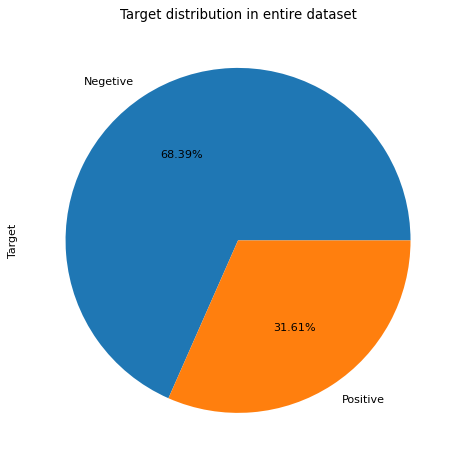

In [28]:
edatools.plot_piechart("Target distribution in entire dataset", pneumonia_data.df_merged_dicom, 
                       'Target', labels=["Negetive", "Positive"])

In [29]:
pneumonia_data.df_merged_dicom_drop_duplicates['Target'].value_counts()

0    20672
1     6012
Name: Target, dtype: int64

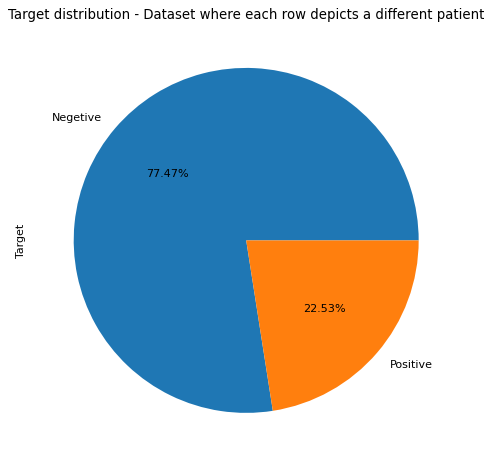

In [30]:
edatools.plot_piechart("Target distribution - Dataset where each row depicts a different patient", pneumonia_data.df_merged_dicom_drop_duplicates, 
                       'Target', labels=["Negetive", "Positive"])

In [31]:
n_pneumonia      = pneumonia_data.df_merged_dicom_drop_duplicates['Target'].value_counts()[1]
n_no_pneumonia = pneumonia_data.df_merged_dicom_drop_duplicates['Target'].value_counts()[0]

print_markdown(f'**Number of patients with Pneumonia in the dataset = {n_pneumonia}**')
print_markdown(f'**Number of patients without Pneumonia in the dataset = {n_no_pneumonia}**')

<span style='color:None'>**Number of patients with Pneumonia in the dataset = 6012**</span>

<span style='color:None'>**Number of patients without Pneumonia in the dataset = 20672**</span>

### EDA - Visualization of Class

In [32]:
pneumonia_data.df_merged_dicom['class'].value_counts()

No Lung Opacity | Not Normal    11821
Lung Opacity                     9555
Normal                           8851
Name: class, dtype: int64

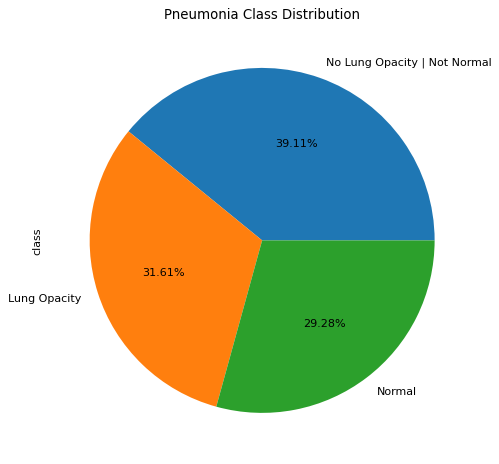

In [33]:
edatools.plot_piechart("Pneumonia Class Distribution", pneumonia_data.df_merged_dicom, 
                       'class')

In [34]:
pneumonia_data.df_merged_dicom_drop_duplicates['class'].value_counts()

No Lung Opacity | Not Normal    11821
Normal                           8851
Lung Opacity                     6012
Name: class, dtype: int64

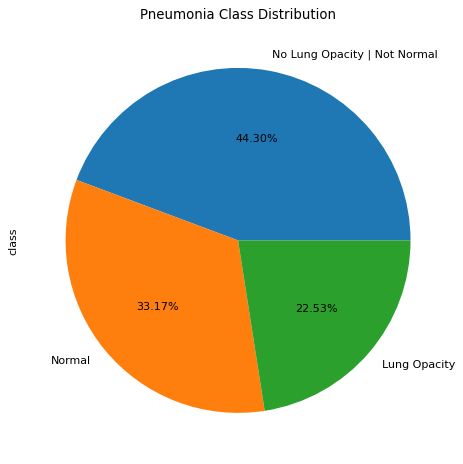

In [35]:
edatools.plot_piechart("Pneumonia Class Distribution", pneumonia_data.df_merged_dicom_drop_duplicates, 
                       'class')

In [36]:
n_lung_opacity = pneumonia_data.df_merged_dicom_drop_duplicates['class'].value_counts()['Lung Opacity']
n_normal       = pneumonia_data.df_merged_dicom_drop_duplicates['class'].value_counts()['Normal']
n_not_normal   = pneumonia_data.df_merged_dicom_drop_duplicates['class'].value_counts()['No Lung Opacity | Not Normal']

print_markdown(f'**Number of patients with Pneumonia or presence of Lung Opacity in the dataset = {n_lung_opacity}**')
print_markdown(f'**Number of patients with Normal Lungs in the dataset = {n_normal}**')
print_markdown(f'**Number of patients with No Lung Opacity | Not Normal Lungs in the dataset = {n_not_normal}**')

<span style='color:None'>**Number of patients with Pneumonia or presence of Lung Opacity in the dataset = 6012**</span>

<span style='color:None'>**Number of patients with Normal Lungs in the dataset = 8851**</span>

<span style='color:None'>**Number of patients with No Lung Opacity | Not Normal Lungs in the dataset = 11821**</span>

### EDA - Bounding Box Analysis

In [37]:
def _get_bounding_box():
    df_pneumonia = pneumonia_data.df_merged_dicom[pneumonia_data.df_merged_dicom.Target==1]
    df_grouped = df_pneumonia.groupby('patientId').agg({'patientId': 'count'})
    df_grouped = df_grouped.rename(columns={'patientId': 'bounding_box_count'}).reset_index()
    
    return df_grouped


In [38]:
df_bounding_box = _get_bounding_box()

In [39]:
df_bounding_box.head()

,patientId,bounding_box_count
0,000db696-cf54-4385-b10b-6b16fbb3f985,2
1,000fe35a-2649-43d4-b027-e67796d412e0,2
2,001031d9-f904-4a23-b3e5-2c088acd19c6,2
3,001916b8-3d30-4935-a5d1-8eaddb1646cd,1
4,0022073f-cec8-42ec-ab5f-bc2314649235,2


In [40]:
df_bounding_box.bounding_box_count.describe()

count    6012.000000
mean        1.589321
std         0.542800
min         1.000000
25%         1.000000
50%         2.000000
75%         2.000000
max         4.000000
Name: bounding_box_count, dtype: float64

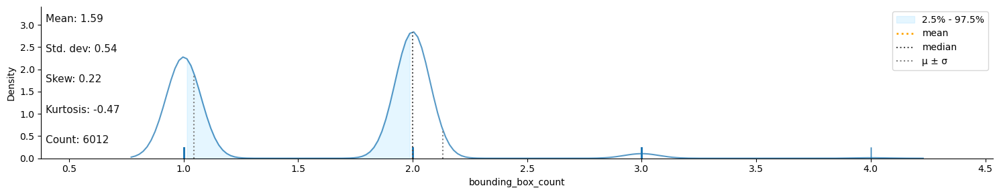

In [41]:
edatools.plot_distribution_with_stats(df_bounding_box, 'bounding_box_count')

**Observations:**

    1. In our dataset where patients have Pneumonia , we have majority of the entries with either 2 or 1 bounding
       box of the affected area.
       
    2. There are only few entries with 3 or more such affected regions

In [42]:
def _get_centroids():
    df_pneumonia = pneumonia_data.df_merged_dicom[pneumonia_data.df_merged_dicom.Target==1]
    df_pneumonia['centroid_x'] = df_pneumonia['x'] + df_pneumonia['width'] / 2
    df_pneumonia['centroid_y'] = df_pneumonia['y'] + df_pneumonia['height'] / 2
    
    return df_pneumonia[['patientId', 'sex', 'age', 'centroid_x', 'centroid_y']]
    
    return df_pneumonia
    

In [43]:
df_centroids = _get_centroids()

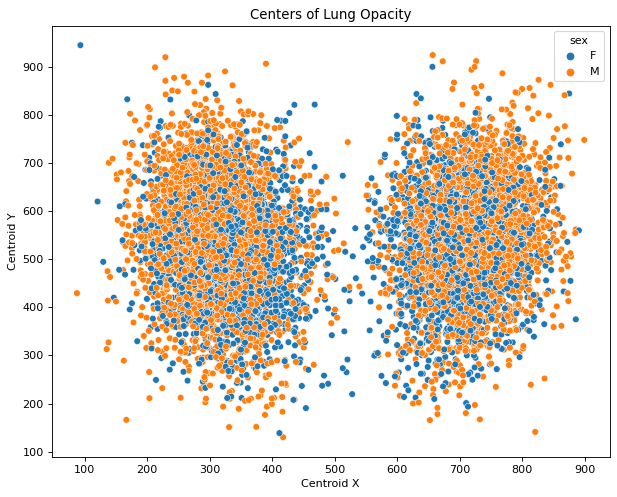

In [44]:
edatools.plot_scatter("Centers of Lung Opacity", 
                      "Centroid X", "Centroid Y", df_centroids,
                      x_col='centroid_x', y_col='centroid_y',
                      hue_col='sex')

### EDA - Age & Gender Analysis

In [45]:
def _get_df_pneumonia():
    df_pneumonia = pneumonia_data.df_merged_dicom_drop_duplicates\
    [pneumonia_data.df_merged_dicom_drop_duplicates.Target==1]
    
    return df_pneumonia[['patientId', 'sex', 'age', 'viewpos']]

def _get_df_pneumonia_by_gender(gender):
    return df_pneumonia[df_pneumonia['sex'] == gender]
    

In [46]:
df_pneumonia = _get_df_pneumonia()

In [47]:
df_pneumonia.head()

,patientId,sex,age,viewpos
4,00436515-870c-4b36-a041-de91049b9ab4,F,32,AP
8,00704310-78a8-4b38-8475-49f4573b2dbb,M,75,PA
14,00aecb01-a116-45a2-956c-08d2fa55433f,F,6,AP
16,00c0b293-48e7-4e16-ac76-9269ba535a62,F,23,AP
19,00f08de1-517e-4652-a04f-d1dc9ee48593,M,58,AP


**Age Distribution in the entire dataset - with and without Pneumonia**

Large dataset detected, using 10000 random samples for the plots. Summary statistics are still based on the entire dataset.


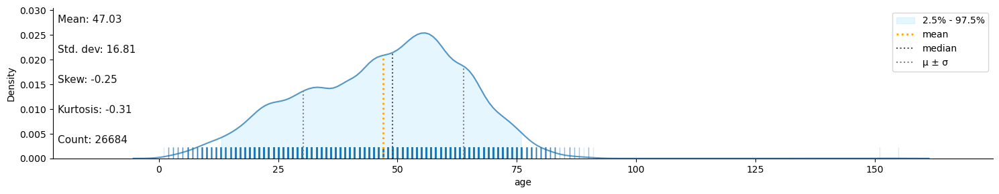

In [48]:
edatools.plot_distribution_with_stats(pneumonia_data.df_merged_dicom_drop_duplicates, 'age')

**Age Distribution in patients with Pneumonia**

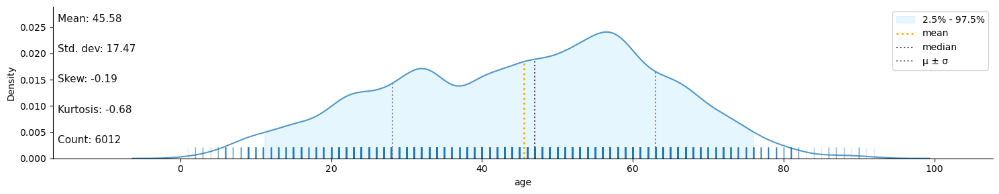

In [49]:
edatools.plot_distribution_with_stats(df_pneumonia, 'age')

**Age Distribution in patients with Pneumonia - Female**

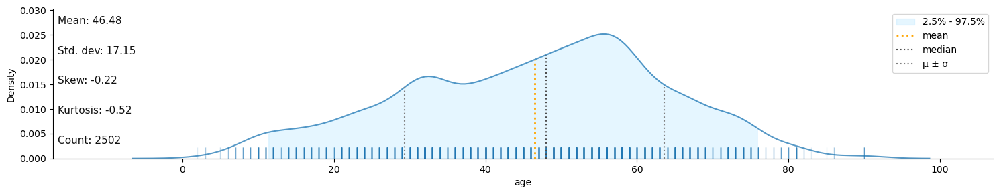

In [50]:
edatools.plot_distribution_with_stats(_get_df_pneumonia_by_gender('F'), 'age')

**Age Distribution in patients with Pneumonia - Male**

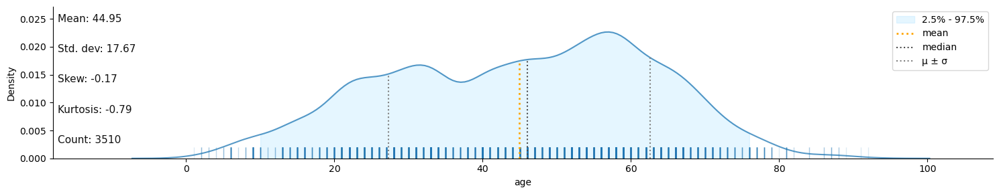

In [51]:
edatools.plot_distribution_with_stats(_get_df_pneumonia_by_gender('M'), 'age')

**Hisogram of Pneumonia count based on age**

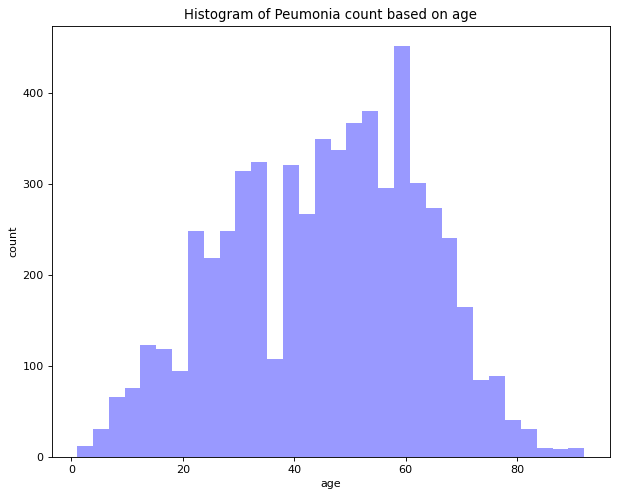

In [52]:
edatools.plot_histogram(df_pneumonia, 'age', 
                        "Histogram of Peumonia count based on age", 
                        "age", "count")

**Age distribution in pateints with Pneumonia with added Gender Hue**

<Figure size 720x560 with 0 Axes>

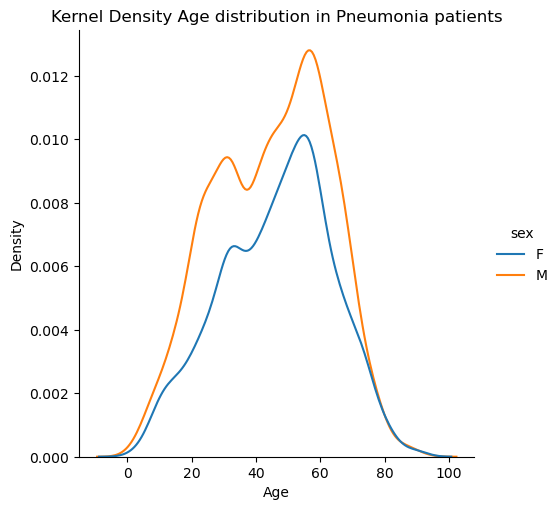

In [53]:
edatools.plot_distribution(df_pneumonia, x_col='age', hue_col='sex',
                           title = "Kernel Density Age distribution in Pneumonia patients", 
                           x_label = "Age", 
                           y_label = "Density",
                           kind='kde')

**Number of Lung opacities and age**

In [54]:
df_pneumonia_bb = datasetutils.merge_dataframes(df_pneumonia, df_bounding_box, 'patientId')

In [55]:
df_pneumonia_bb.head()

,patientId,sex,age,viewpos,bounding_box_count
0,00436515-870c-4b36-a041-de91049b9ab4,F,32,AP,2
1,00704310-78a8-4b38-8475-49f4573b2dbb,M,75,PA,2
2,00aecb01-a116-45a2-956c-08d2fa55433f,F,6,AP,2
3,00c0b293-48e7-4e16-ac76-9269ba535a62,F,23,AP,2
4,00f08de1-517e-4652-a04f-d1dc9ee48593,M,58,AP,2


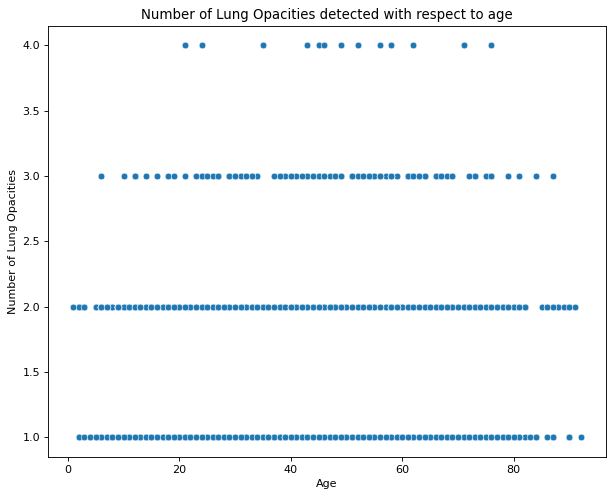

In [56]:
edatools.plot_scatter("Number of Lung Opacities detected with respect to age", "Age", 
                      "Number of Lung Opacities",
                      df_pneumonia_bb, x_col='age', y_col='bounding_box_count', hue_col=None)

**Gender distribution of Pneumonia cases in the dataset**

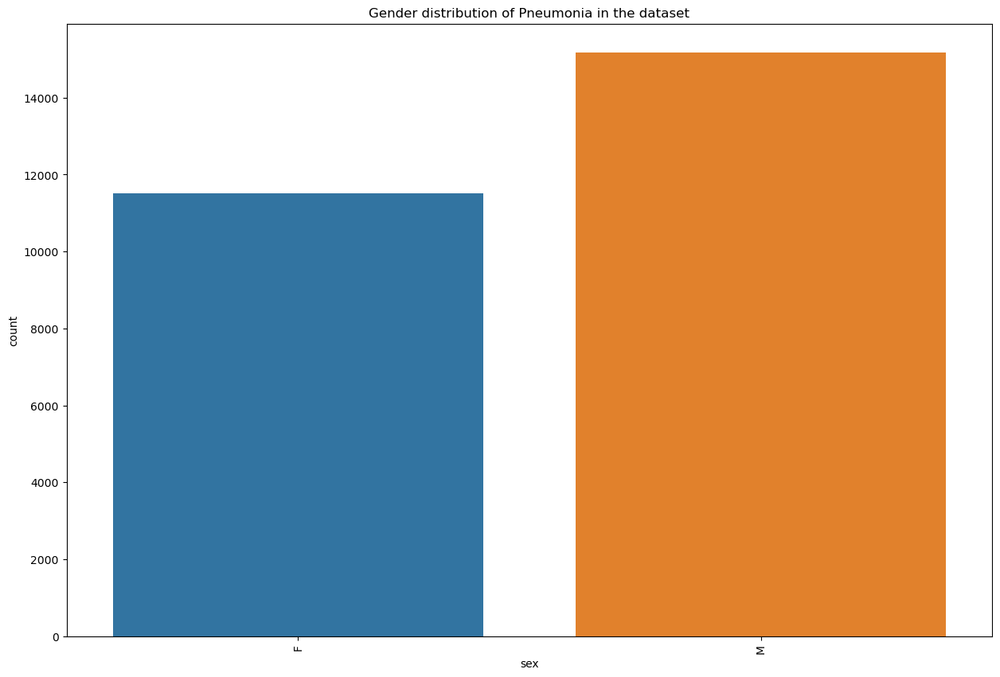

In [57]:
edatools.plot_count("Gender distribution of Pneumonia in the dataset", 
                    pneumonia_data.df_merged_dicom_drop_duplicates, 
                    'sex', hue_col_name=None)

**Count plot of Target for different Genders**

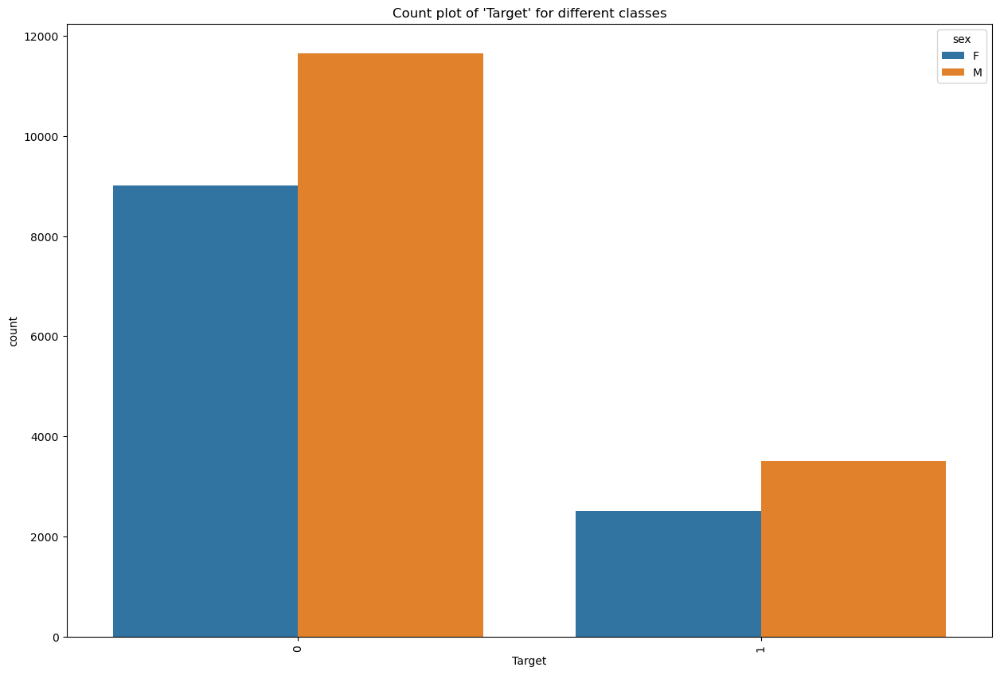

In [58]:
edatools.plot_count("Count plot of 'Target' for different classes", 
                    pneumonia_data.df_merged_dicom_drop_duplicates, 
                    'Target', hue_col_name='sex')

**Count plot of Class for different Genders**

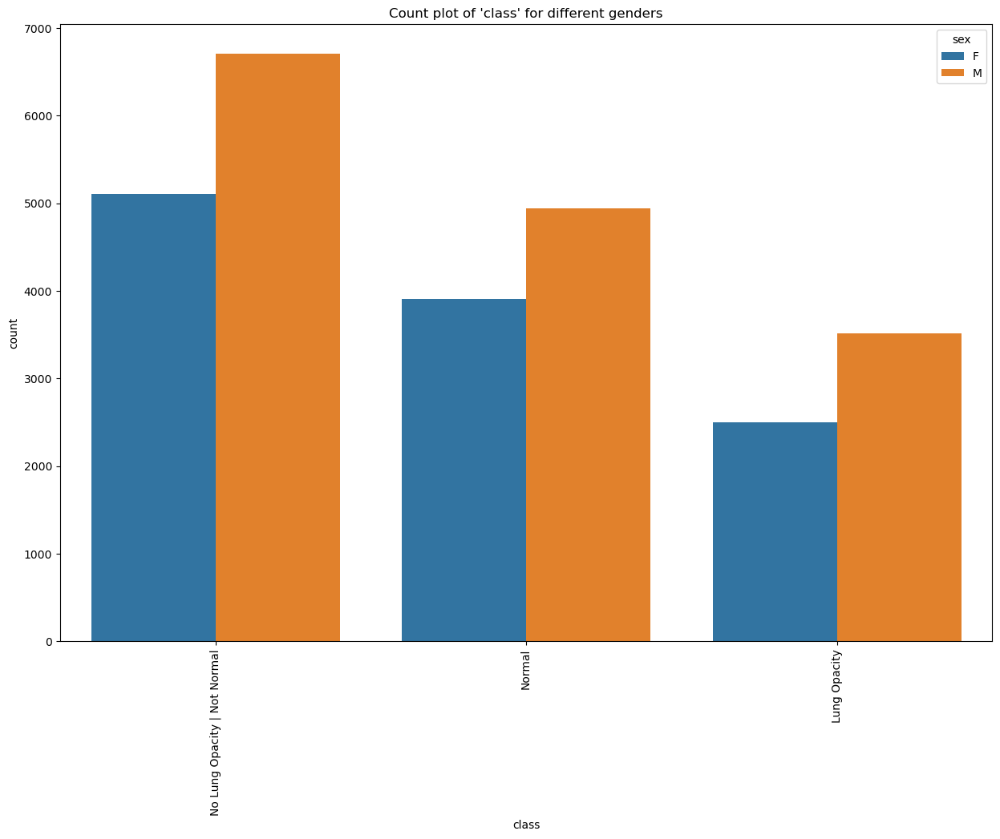

In [59]:
edatools.plot_count("Count plot of 'class' for different genders", 
                    pneumonia_data.df_merged_dicom_drop_duplicates, 
                    'class', hue_col_name='sex')

### EDA - View Positions

**View position distribution on the entire dataset**

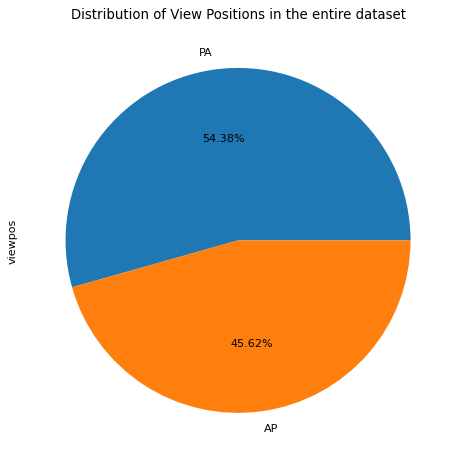

In [60]:
edatools.plot_piechart("Distribution of View Positions in the entire dataset", 
                       pneumonia_data.df_merged_dicom_drop_duplicates, 
                       'viewpos', labels=None)

**View position distribution in Pneumonia patients**

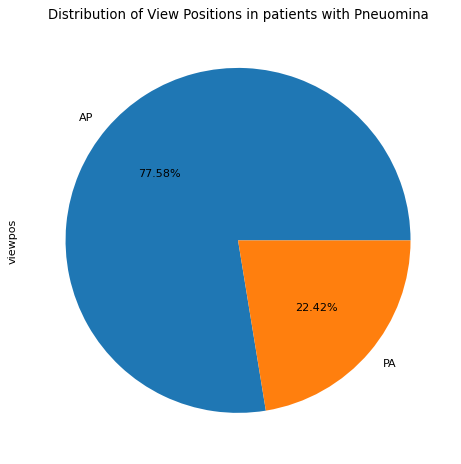

In [61]:
edatools.plot_piechart("Distribution of View Positions in patients with Pneuomina",
                       df_pneumonia, 
                       'viewpos', labels=None)

## 4.) Preprocessing and Visualisation of different classes

In [62]:
resize_image_width  = 128
resize_image_height = 128

#pre-process a single image given the path
def pre_process_image(image_path):
    #read and get pixel data from dicom image
    dicom_data = dicom.read_file(image_path)
    dicom_image = dicom_data.pixel_array
    #convert to np.array
    img = np.array(dicom_image).astype(np.uint8)
    #sharpen filter kernel and conversion
    kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
    img_sharp = cv2.filter2D(img, -1, kernel)
    #image re-size
    img_res = cv2.resize(img_sharp, (resize_image_width, resize_image_height), 
                         interpolation = cv2.INTER_LINEAR)
    
    #convert 2D array to 3D array
    img_res = np.expand_dims(img_res, axis=-1)

    return img_res

**We will now call the above function on each image in the dataset and process the same. The resulting
  data will be stored in the dataframe itself as a new caloumn called 'image_array'**

In [63]:
pneumonia_data.pre_process_images(pre_process_image)

In [64]:
pneumonia_data.df_merged_dicom_drop_duplicates.iloc[0]['image_array'].shape

(128, 128, 1)

In [65]:
class ImageUtils:
    def display_dicom_samples(self, tile_header, samples, images_per_row=3, bounding_box=False):
        print_markdown(f'<h2 style="font-size:20px;">{tile_header}</h2>')
        i = 0
        count = len(samples)
        n_rows = count // images_per_row
        
        #set squeeze option to make the axes always 2D
        fig, axes = plt.subplots(n_rows, images_per_row, squeeze=False, figsize = (20, 20))
        
        for patientId, sample in samples.items():
            dicom_image = dicom.dcmread(sample['image_path'])
            
            ax = axes[i//images_per_row, i % images_per_row]
            ax.imshow(dicom_image.pixel_array, cmap = plt.cm.bone)
            ax.set_title(f"class = {sample['impression']}, Age = {sample['age']}, Gender = {sample['gender']}, ViewPos = {sample['viewpos']}")
            ax.axis('off')
            
            if bounding_box:
                try:
                    bounding_boxes = sample['bounding_box']
                    for bounding_box in bounding_boxes:
                        rect = Rectangle(xy = (bounding_box['x'], bounding_box['y']), 
                                                 width = bounding_box['width'], 
                                                 height = bounding_box['height'], 
                                                 fill=False, color='red')
                        ax.add_patch(rect)
                except KeyError as error:
                    pass

            i+=1
            
        plt.show()
        print_markdown("<hr>")
        
image_utils = ImageUtils()

In [66]:
#The PneumoniaData class has a helper method called get_random_samples that returns random samples
#of images based on viewpos and impression. It also gets all the bounding boxes for samples where 
#Pneumonia is detected. Note for a given patientId in some cases where Pneumonia was detected, there
#are multiple rows. These are depecting different bounding boxes for the same.
def _display_sample_images(viewpos):
    impressions = pneumonia_data.df_merged_dicom['class'].unique()
    for impression in impressions:
        impression_samples = pneumonia_data.get_random_samples(view_pos=viewpos, impression=impression, count=4)
        image_utils.display_dicom_samples(f"Sample images where impression is {impression}", 
                                  impression_samples, images_per_row=2)    

### Samples images of different classes - PA (posteroa|nterior) View

We have three classes (Normal, No Lung Opacity / Not Normal, Lung Opacity)

<span style='color:None'><h2 style="font-size:20px;">Sample images where impression is No Lung Opacity | Not Normal</h2></span>

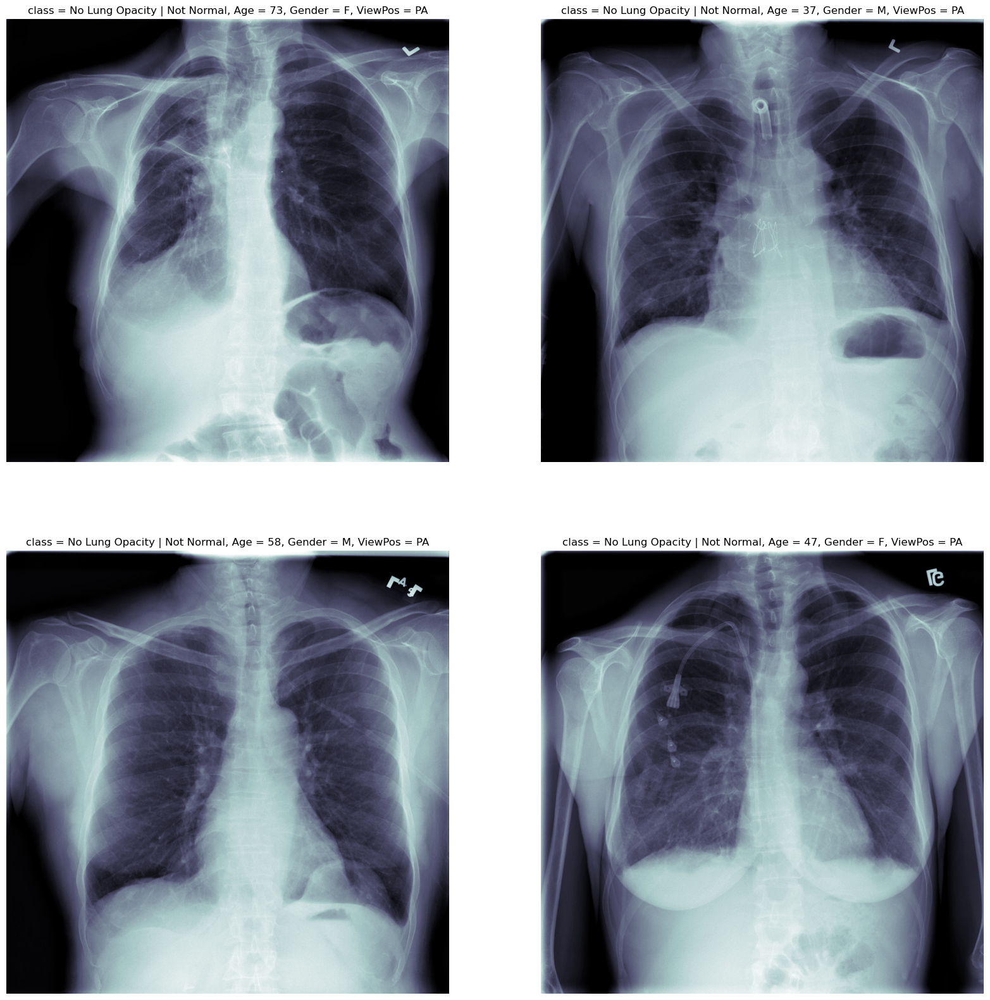

<span style='color:None'><hr></span>

<span style='color:None'><h2 style="font-size:20px;">Sample images where impression is Normal</h2></span>

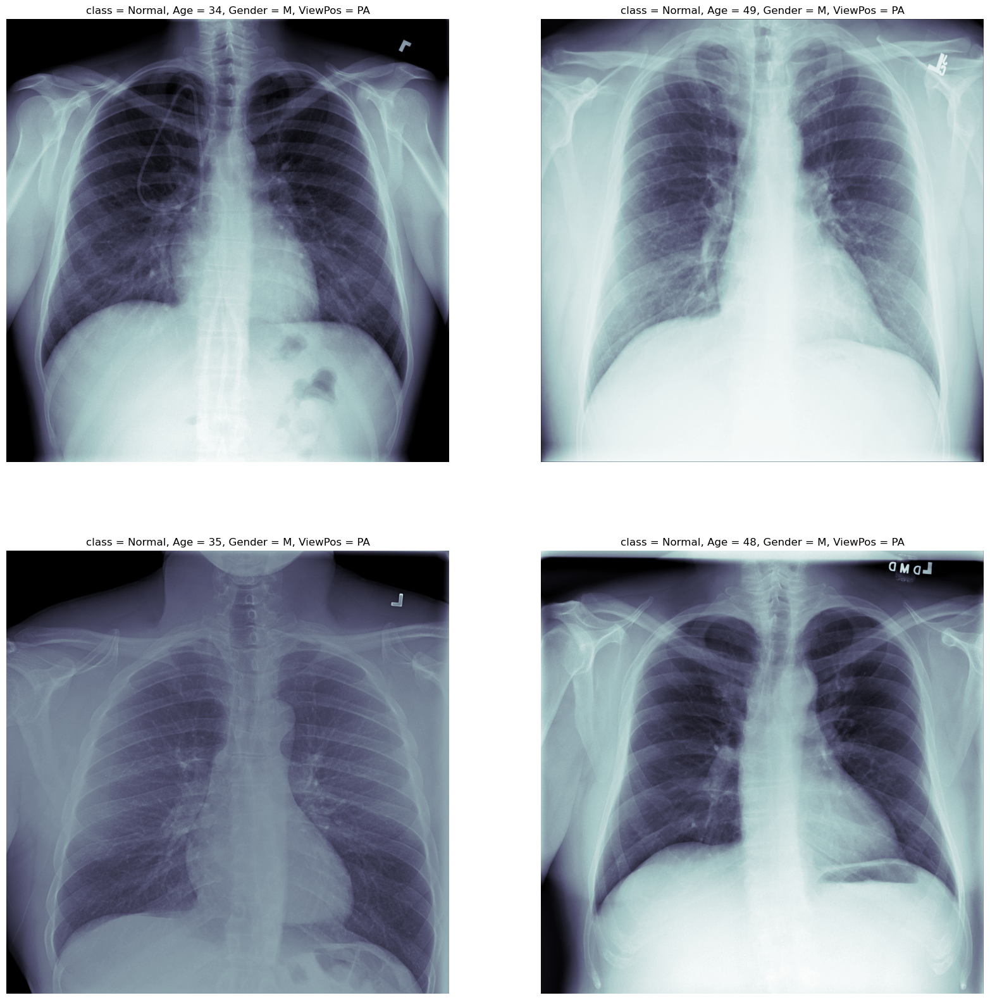

<span style='color:None'><hr></span>

<span style='color:None'><h2 style="font-size:20px;">Sample images where impression is Lung Opacity</h2></span>

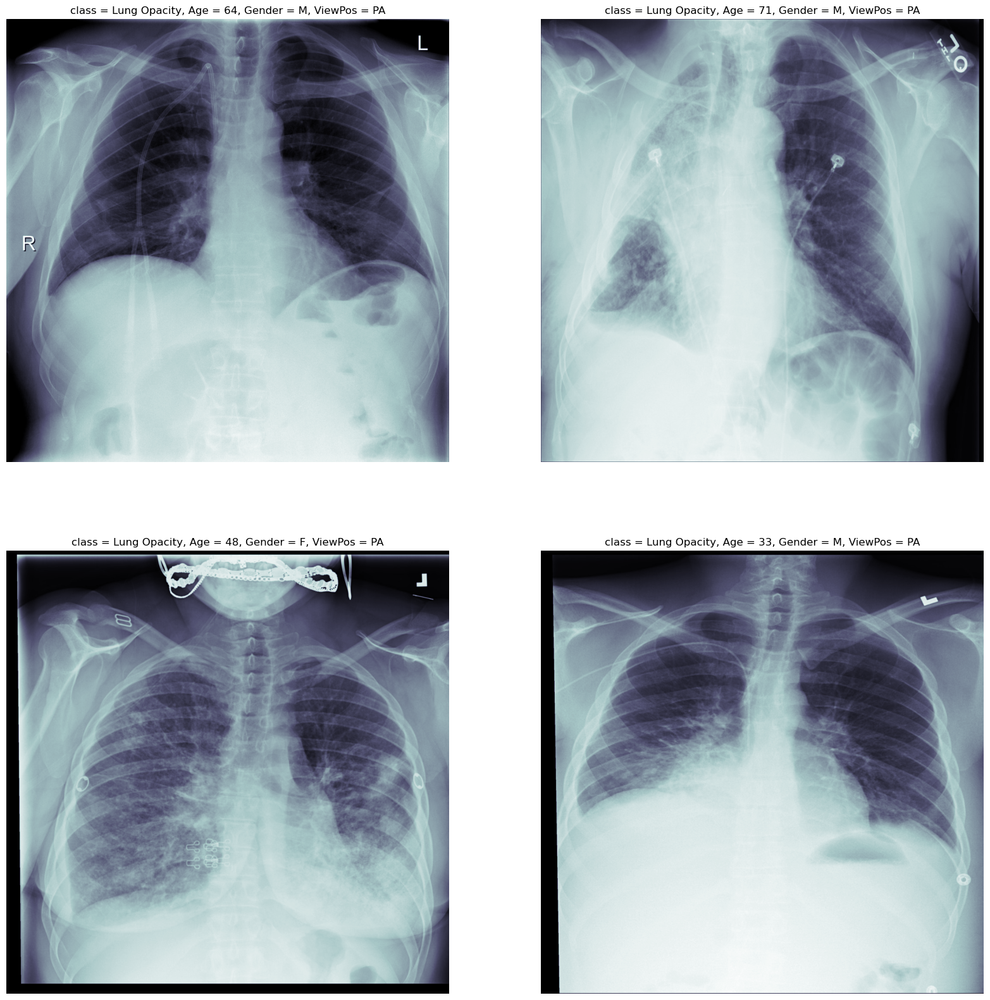

<span style='color:None'><hr></span>

In [67]:
_display_sample_images("PA")

### Samples images of different classes - AP (anteroposterior) View

We have three classes (Normal, No Lung Opacity / Not Normal, Lung Opacity)

<span style='color:None'><h2 style="font-size:20px;">Sample images where impression is No Lung Opacity | Not Normal</h2></span>

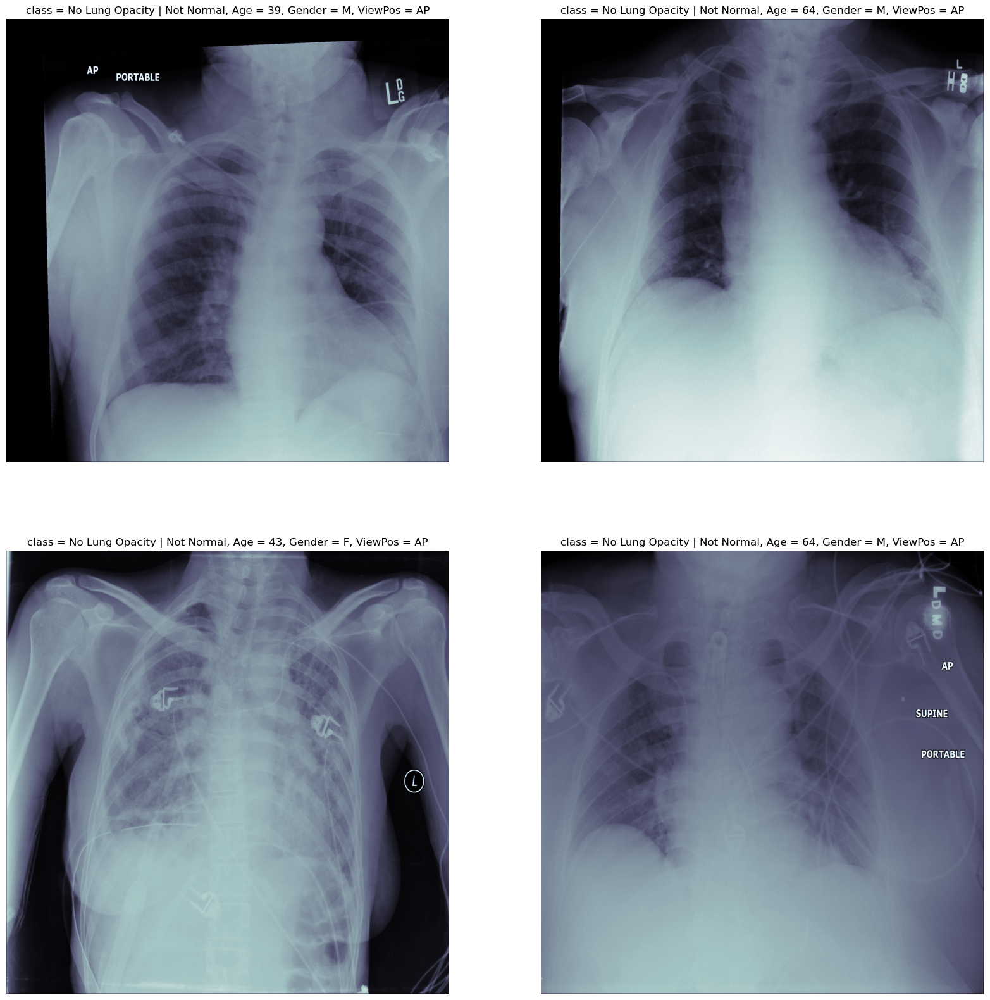

<span style='color:None'><hr></span>

<span style='color:None'><h2 style="font-size:20px;">Sample images where impression is Normal</h2></span>

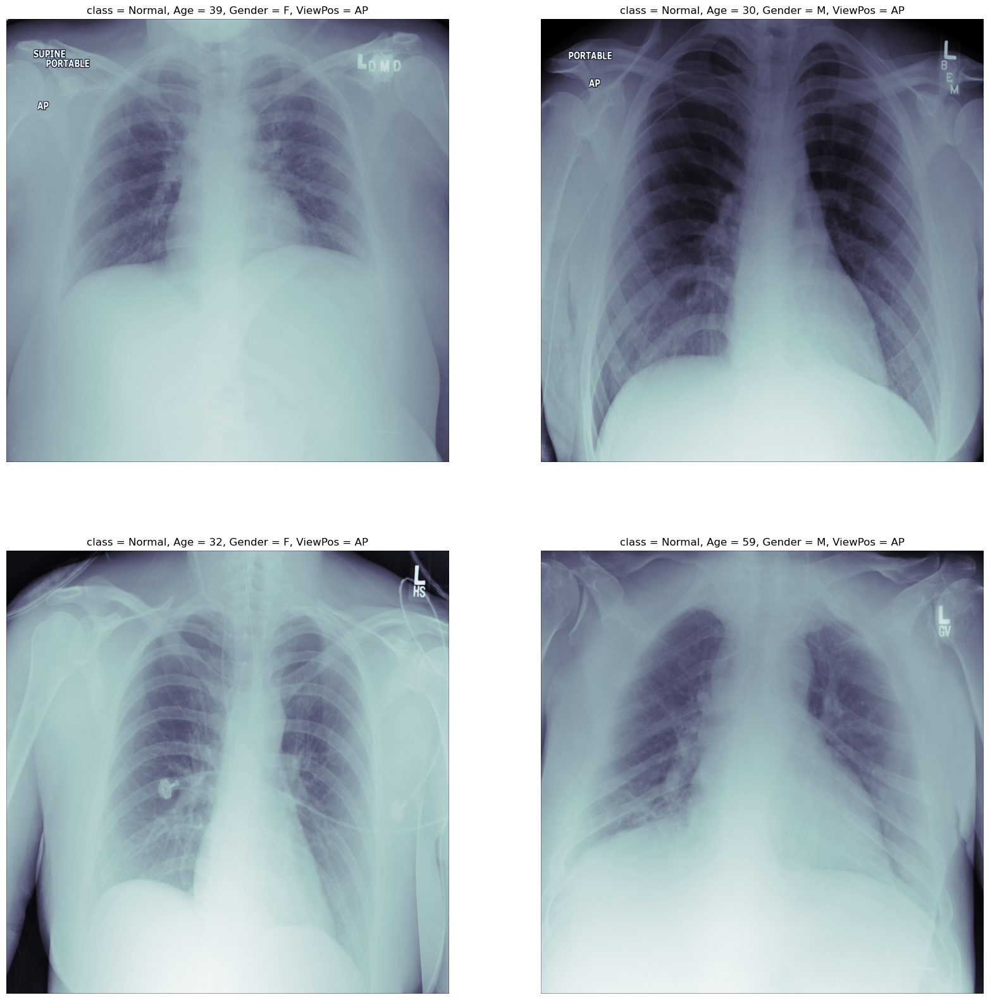

<span style='color:None'><hr></span>

<span style='color:None'><h2 style="font-size:20px;">Sample images where impression is Lung Opacity</h2></span>

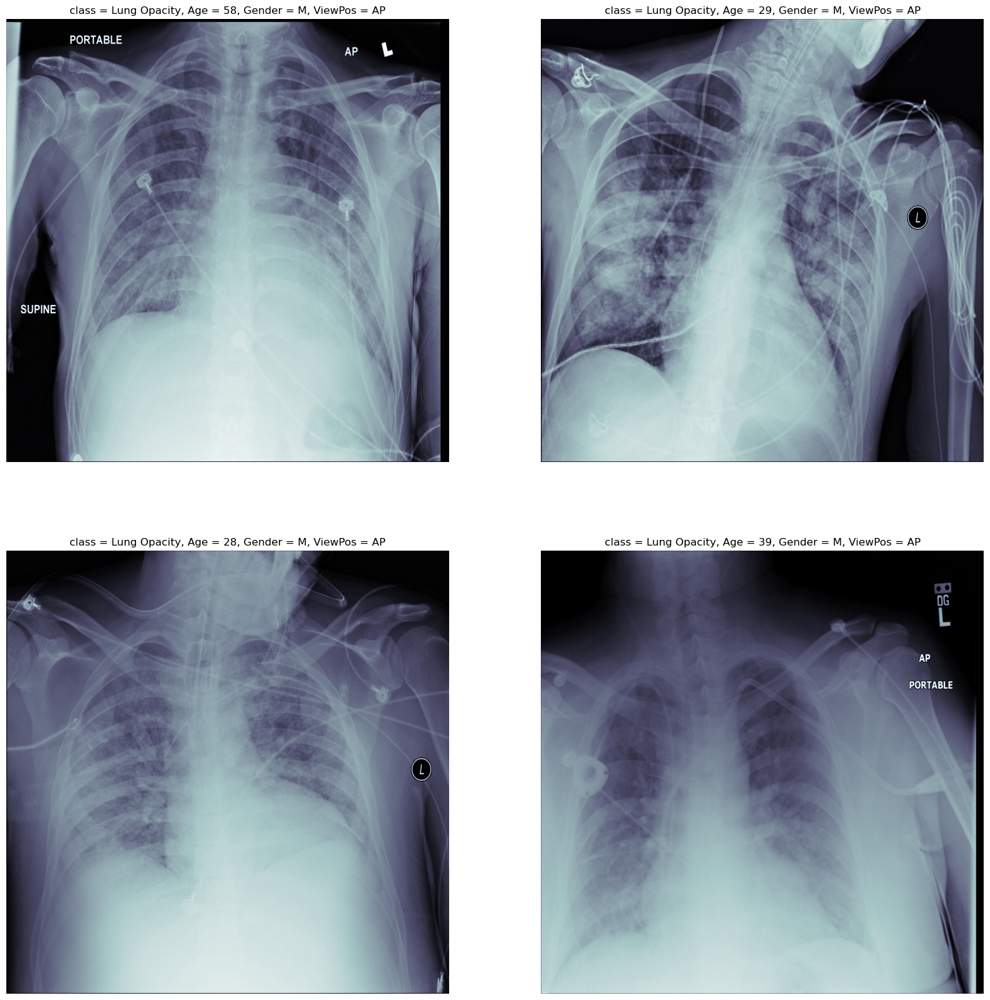

<span style='color:None'><hr></span>

In [68]:
_display_sample_images("AP")

## 5.) Display images with bounding box.

In [69]:
def _display_sample_images_with_bounding_box(viewpos):
    impression = 'Lung Opacity'
    
    impression_samples = pneumonia_data.get_random_samples(view_pos=viewpos, 
                                                           impression = impression, count=6)
    
    image_utils.display_dicom_samples(f"Sample images where impression is {impression}", 
                                  impression_samples, images_per_row=2, bounding_box=True)
        

### Samples images with bounding box - Posterior-Anterior (PA) view

<span style='color:None'><h2 style="font-size:20px;">Sample images where impression is Lung Opacity</h2></span>

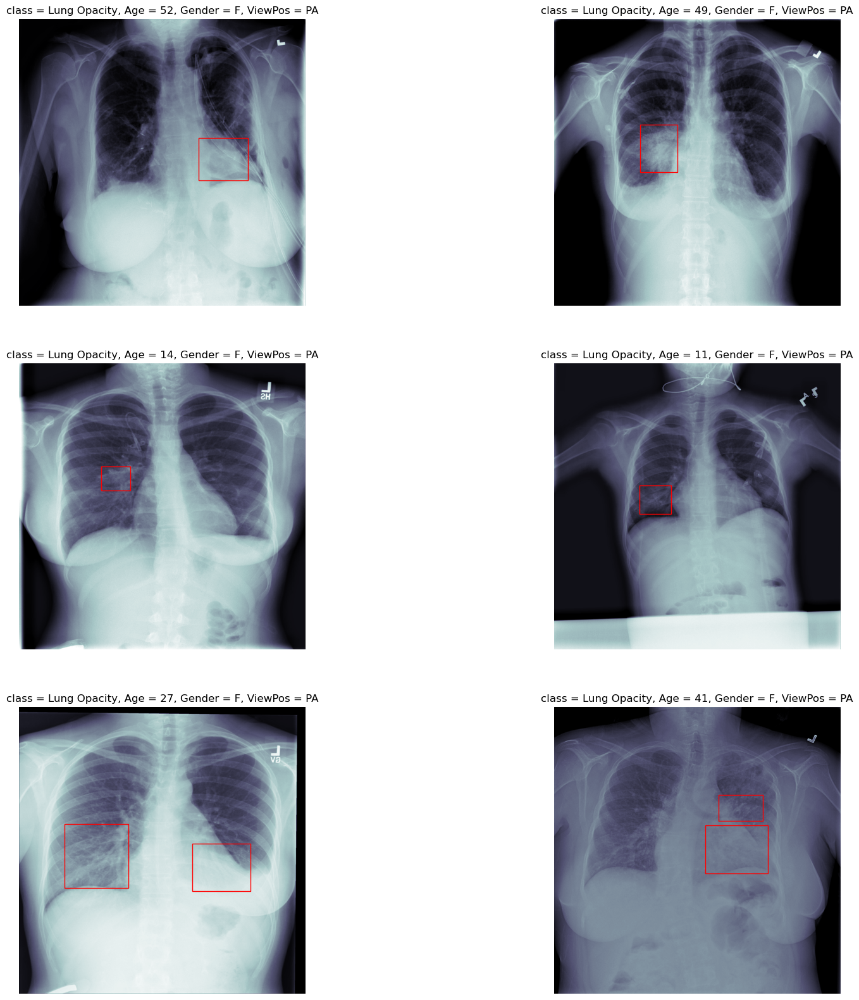

<span style='color:None'><hr></span>

In [70]:
_display_sample_images_with_bounding_box("PA")

### Samples images with bounding box - Antero-Posterior (AP) view

<span style='color:None'><h2 style="font-size:20px;">Sample images where impression is Lung Opacity</h2></span>

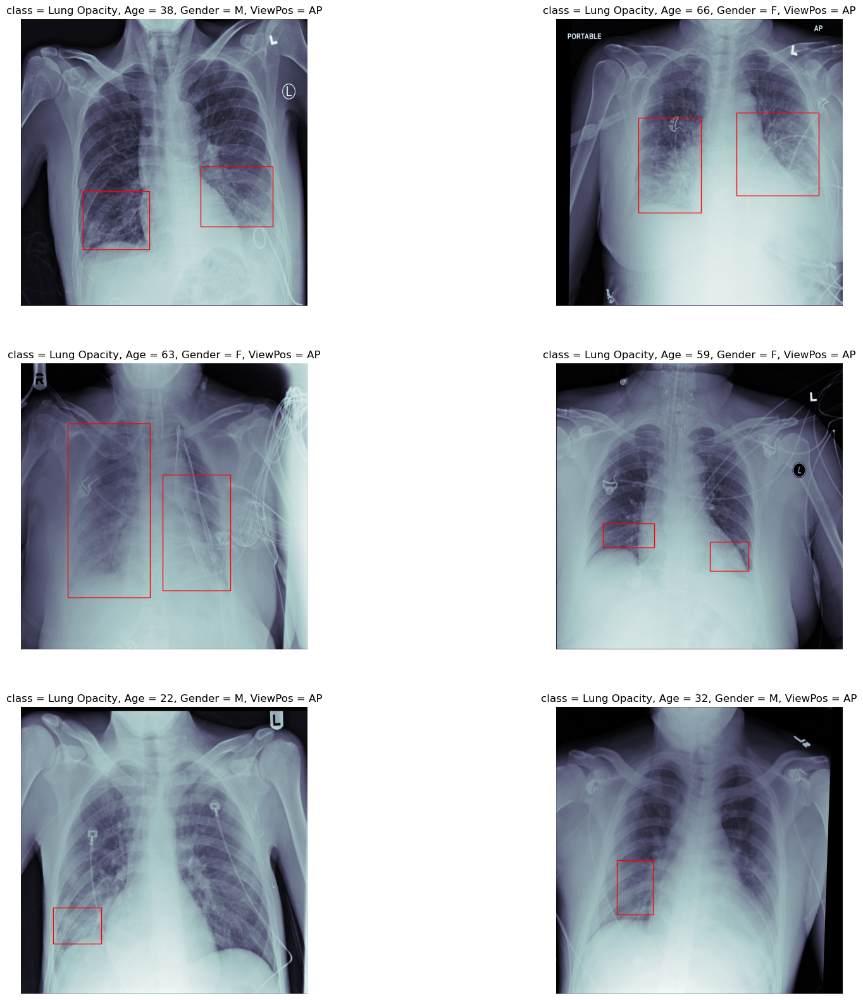

<span style='color:None'><hr></span>

In [71]:
_display_sample_images_with_bounding_box("AP")

### Some sample images where number of Lung Opacities  are more (4)

In [72]:
def _display_samples_with_bb_count(bb_count):
    sample_ids = df_bounding_box[df_bounding_box.bounding_box_count == bb_count].sample(4)['patientId'].tolist()
    samples = pneumonia_data.df_merged_dicom_drop_duplicates[pneumonia_data.df_merged_dicom_drop_duplicates['patientId'].isin(sample_ids)]
    impression_samples = pneumonia_data.get_data_for_samples(samples)
    
    image_utils.display_dicom_samples(f"Images where number of detected Lung Opacities are more", 
                                  impression_samples, images_per_row=2, bounding_box=True)

<span style='color:None'><h2 style="font-size:20px;">Images where number of detected Lung Opacities are more</h2></span>

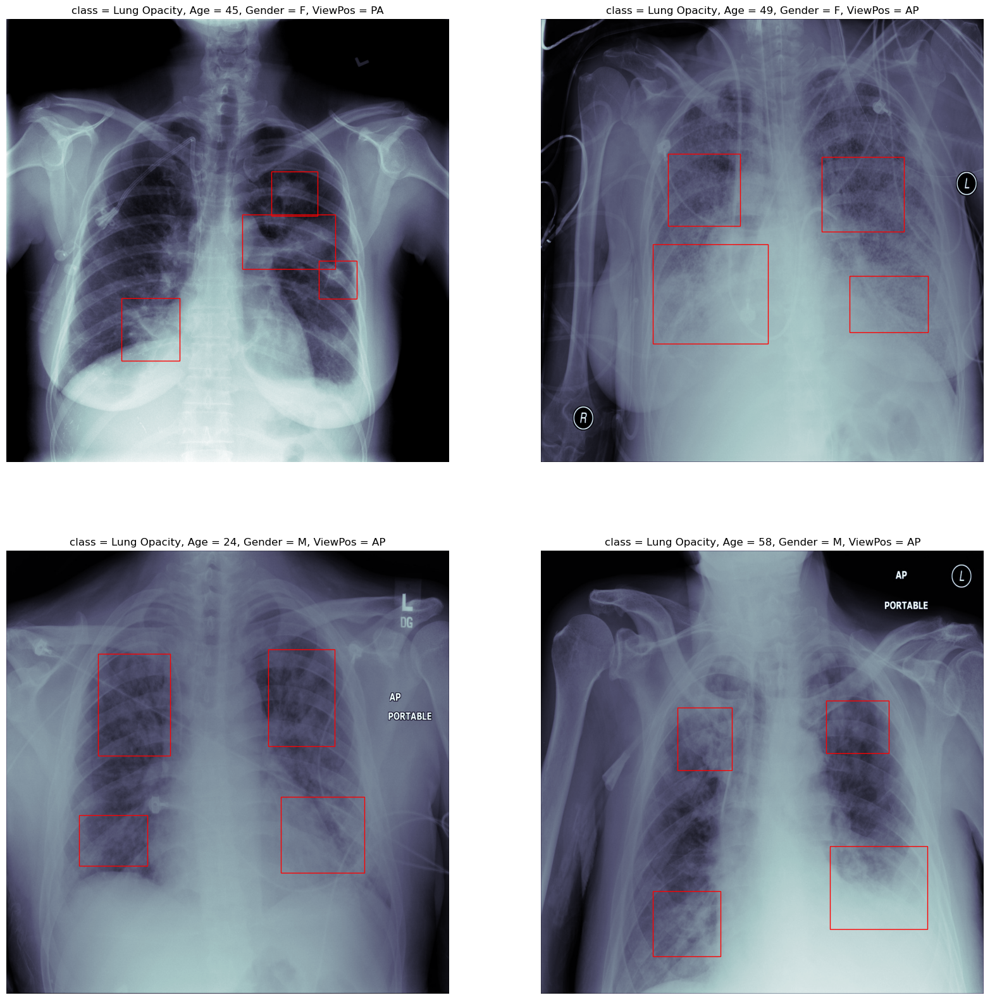

<span style='color:None'><hr></span>

In [73]:
_display_samples_with_bb_count(4)

## 6.) Design, train and test basic CNN models for classification.

In [74]:
#normalize pixel values of images to a range between (0,1)
def normalize_image(X):
    X_norm = X / 255.0
    return X_norm

#First encode the labels and then convert them to categorical
def encode_cat(y):
    le = LabelEncoder()
    encodedY = le.fit_transform(y)
    y_cat = to_categorical(encodedY)
    return le, y_cat

#encode the labels
def encode_label(y):
    le = LabelEncoder()
    encodedY = le.fit_transform(y)
    return le, encodedY

#get train and test data
def get_train_test(X, y, test_size=0.2):
    return train_test_split(X, y, stratify = y, test_size = test_size)

#display value counts for an array
def display_nparray_value_counts(name, arr):
    print(f'{name} unique values = {np.unique(arr, return_counts=True)}\n')
    
#normalize and convert to features and target
def get_normalize_image_labels(X_train, y_train, X_val, y_val, X_test, y_test):
    #convert to arrays
    X_train = normalize_image(np.array(X_train['image_array'].values.tolist()))
    y_train = np.array(y_train)
    
    X_val = normalize_image(np.array(X_val['image_array'].values.tolist()))
    y_val = np.array(y_val)
    
    X_test = normalize_image(np.array(X_test['image_array'].values.tolist()))
    y_test = np.array(y_test)
    
    return X_train, y_train, X_val, y_val, X_test, y_test

#display shapes of train, val and test data
def display_shapes(X_train, y_train, X_val, y_val, X_test, y_test):
    print(f'X_train shape = {X_train.shape}\n')
    print(f'y_train shape = {y_train.shape}\n')
    print(f'X_val shape   = {X_val.shape}\n')
    print(f'y_val shape   = {y_val.shape}\n')
    print(f'X_test shape  = {X_test.shape}\n')
    print(f'y_test shape  = {y_test.shape}\n')

### Class Ratio 2:1:1

'Lung Opacity' cases will occupy 50% forming Target 1. 'Normal' and 'No Lung Opacity | Not Normal' will add upto 50% forming Target 0. Further 'Normal' and 'No Lung Opacity | Not Normal' will be in equal propotion. 

Hence the class ratio of 2:1:1

In [75]:
#get data based on the statergy of balancing the 3 classes Lung Opacity, Normal, Not Normal
#in the ratio of 2:1:1. This would make the Target 1 : Target 0 ratio 1:1
#as 'Normal' and 'Not Normal' are both Target 0
def _get_balanced_data():
    random_state = 7
    #assign target 1 class train and val / test sizes
    target_1_train_size = 3612
    target_1_val_size = 1200
    
    #derive target 0 class train and val / test sizes.
    target_0_train_size = int(target_1_train_size/2)
    target_0_size_val_test = int(target_1_val_size/2)
    
    df_pruned = pneumonia_data.df_merged_dicom_drop_duplicates.copy()

    #Get data for specific classes
    df_not_normal = df_pruned[df_pruned['class'] == 'No Lung Opacity | Not Normal']
    df_normal = df_pruned[df_pruned['class'] == 'Normal']
    df_pneuomina = df_pruned[df_pruned['class'] == 'Lung Opacity']


    #Sample and remove the sampled data from 'Lung Opacity' related df and assign different
    #buckets to train, val and test
    df_train_pneumonia = datasetutils.sample_and_remove(df_pneuomina, n=target_1_train_size, random_state=random_state)
    df_val_pneumonia   = datasetutils.sample_and_remove(df_pneuomina, n=target_1_val_size, random_state=random_state)
    df_test_pneumonia  = datasetutils.sample_and_remove(df_pneuomina, n=target_1_val_size, random_state=random_state)
    
    #Sample and remove the sampled data from 'Normal' related df and assign different
    #buckets to train, val and test
    df_train_normal    = datasetutils.sample_and_remove(df_normal, n=target_0_train_size, random_state=random_state)
    df_val_normal      = datasetutils.sample_and_remove(df_normal, n=target_0_size_val_test, random_state=random_state)
    df_test_normal     = datasetutils.sample_and_remove(df_normal, n=target_0_size_val_test, random_state=random_state)

    #Sample and remove the sampled data from 'Not Normal' related df and assign different
    #buckets to train, val and test
    df_train_not_normal = datasetutils.sample_and_remove(df_not_normal, n=target_0_train_size, random_state=random_state)
    df_val_not_normal   = datasetutils.sample_and_remove(df_not_normal, n=target_0_size_val_test, random_state=random_state)
    df_test_not_normal  = datasetutils.sample_and_remove(df_not_normal, n=target_0_size_val_test, random_state=random_state)

    #For overall balanced data for train, val and test
    df_balanced_train = shuffle(pd.concat([df_train_pneumonia, df_train_normal, df_train_not_normal]))
    df_balanced_val = shuffle(pd.concat([df_val_pneumonia, df_val_normal, df_val_not_normal]))
    df_balanced_test = shuffle(pd.concat([df_test_pneumonia, df_test_normal, df_test_not_normal]))
    
    
    #Checking for duplicates
    s1 = df_balanced_train['patientId']
    s2 = df_balanced_val['patientId']
    s3 = df_balanced_test['patientId']
    
    df_check = pd.concat([s1, s2, s3], axis=0)

    # Check for duplicates across all columns
    duplicates = df_check.duplicated().any()
    print(f'Presence of duplicates = {duplicates} : shape = {df_check.shape}\n')

    #For train, val and test X,y
    X_train = df_balanced_train.drop('Target', axis=1)
    y_train = df_balanced_train['Target']
    
    X_val = df_balanced_val.drop('Target', axis=1)
    y_val = df_balanced_val['Target']
    
    X_test = df_balanced_test.drop('Target', axis=1)
    y_test = df_balanced_test['Target']
    
    return X_train, y_train, X_val, y_val, X_test, y_test
    

In [76]:
X_train_balanced, y_train_balanced, X_val_balanced, y_val_balanced, X_test_balanced, y_test_balanced = _get_balanced_data()
display_shapes(X_train_balanced, y_train_balanced, X_val_balanced, y_val_balanced, X_test_balanced, y_test_balanced)


Presence of duplicates = False : shape = (12024,)

X_train shape = (7224, 13)

y_train shape = (7224,)

X_val shape   = (2400, 13)

y_val shape   = (2400,)

X_test shape  = (2400, 13)

y_test shape  = (2400,)



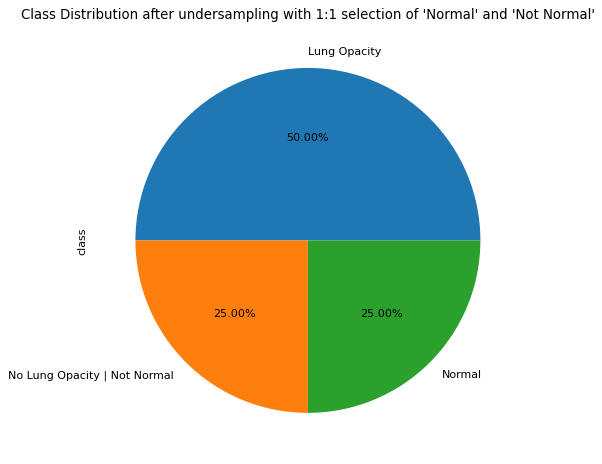

In [77]:
edatools.plot_piechart("Class Distribution after undersampling with 1:1 selection of 'Normal' and 'Not Normal'", X_train_balanced, 
                       'class')

In [78]:
X_train_balanced, y_train_balanced, X_val_balanced, y_val_balanced, X_test_balanced, y_test_balanced = get_normalize_image_labels(X_train_balanced, y_train_balanced, X_val_balanced, y_val_balanced, X_test_balanced, y_test_balanced)

In [79]:
display_nparray_value_counts("y_train_balanced", y_train_balanced)
display_nparray_value_counts("X_val_balanced", y_val_balanced)
display_nparray_value_counts("y_test_balanced", y_test_balanced)

y_train_balanced unique values = (array([0, 1]), array([3612, 3612]))

X_val_balanced unique values = (array([0, 1]), array([1200, 1200]))

y_test_balanced unique values = (array([0, 1]), array([1200, 1200]))



In [80]:
#Base class image classifier
class ImageClassifier:
    def __init__(self, name, X_train, y_train, X_val, y_val):
        self.model_weights_name = 'model_weights.h5'
        
        self.checkpoint = ModelCheckpoint('model_weights.h5', monitor='val_loss', 
                                          verbose=1, save_best_only=True, mode='min')

        self.reduce_lr = ReduceLROnPlateau(monitor = 'val_loss', factor=0.1,
                                           patience = 2, min_lr = 0.00001, model='auto')
        
        self.early_stopping = EarlyStopping(monitor="val_loss", patience=3, restore_best_weights=True)
    
        #default epocs
        self.num_epochs = 3
        #default batch size
        self.batch_size = 32
        #average method for f1, roc scores
        self.average = 'binary'
        
        #name
        self.name = name
        #training data
        self.train_X = X_train
        self.train_y = y_train
        #test data
        self.val_X = X_val
        self.val_y = y_val
        
        #the model
        self.model = None
        #training history
        self.training_history = None
        #metrics
        self.metrics = dict()
        
        
    #We will let the derived class implement it
    def create_model(self):
        pass
                 
    #train model
    def train(self):
        self.monitoring_callacks = [self.checkpoint, self.reduce_lr, self.early_stopping]
        #Fit Model
        self.training_history = self.model.fit(self.train_X, self.train_y, 
                                               validation_data=(self.val_X, self.val_y),
                                               epochs=self.num_epochs, 
                                               batch_size=self.batch_size, 
                                               callbacks=self.monitoring_callacks,
                                               verbose=1)
        return self.training_history
    
    #plot the model
    def plot_model(self):
        return plot_model(self.model, show_shapes=True, 
                   show_layer_names=True, 
                   rankdir='TB', expand_nested=True)
    
    #visualize the model
    def visualize_model(self):
        return visualkeras.layered_view(self.model,legend=True)

    #plot train / val loss against epocs
    def plot_loss_against_epoc(self):
        figure(figsize=(9, 7), dpi=80)
        plt.plot(self.training_history.history['loss'])
        plt.plot(self.training_history.history['val_loss'])
        plt.title(f'Training loss curve for {self.name}\n')
        plt.ylabel('loss')
        plt.xlabel('epoch')
        plt.legend(['training', 'validation'], loc='best')
        plt.show()
    
    #plot train / val accuracy against epochs
    def plot_accuracy_against_epoc(self):
        figure(figsize=(9, 7), dpi=80)
        plt.plot(self.training_history.history['accuracy'])
        plt.plot(self.training_history.history['val_accuracy'])
        plt.title(f'Training accuracy curve for {self.name}\n')
        plt.ylabel('accuracy')
        plt.xlabel('epoch')
        plt.legend(['training', 'validation'], loc='best')
        plt.show()
    
    #predict data
    def predict(self, X_test):
        return np.squeeze(self.model.predict(X_test))

    #predict label based on the default probability cutt off 0.5
    def predict_labels(self, preds):
        for idx, val in enumerate(preds):
            if val > 0.5:
                preds[idx] = 1
            else:
                preds[idx] = 0

        return preds
    
    #prediction for categorical y
    def predict_cat(self, X_test, y_test):
        y_actual = []
        y_pred_final = []
        y_pred = self.model.predict(X_test)
        for i in y_pred:
            y_pred_final.append(np.argmax(i))
    
        for y in y_test:
            y_actual.append(np.argmax(y))

        return y_actual, y_pred_final
    
    #load saved model after training
    def load_saved_model(self):
        self.model = load_model(self.model_weights_name)
        
    #get various metrics like precision, recall, f1, accuracy, rocauc etc        
    def evaluate_metrics(self, X_test, y_test):
        #Predict 
        y_test_probs = self.predict(X_test)
        y_test_pred = self.predict_labels(y_test_probs)

        fpr, tpr, thresholds = roc_curve(y_test, y_test_probs, pos_label=1)
        rocauc = auc(fpr, tpr)

        #Get various metrics
        testing_accuracy = accuracy_score(y_test, y_test_pred)
        precision = precision_score(y_test, y_test_pred, average=self.average)
        recall = recall_score(y_test, y_test_pred, average=self.average)
        f1 = f1_score(y_test, y_test_pred, average=self.average)

        #Populate results in a dictionary
        self.metrics['actual'] = y_test
        self.metrics['preds'] = y_test_pred
        self.metrics['probs'] = y_test_probs
        self.metrics['testing_accuracy'] = testing_accuracy
        self.metrics['precision'] = precision
        self.metrics['recall'] = recall
        self.metrics['f1'] = f1
        self.metrics['roc_auc'] = rocauc

    #display the metrics
    def print_model_metrics(self):
        print(f'Metrics for {self.name}:\n')
        print(f'Testing Accuracy = {self.metrics["testing_accuracy"]}\n')
        print(f'Precision score = {self.metrics["precision"]}\n')
        print(f'Recall score = {self.metrics["recall"]}\n')
        print(f'F1 score = {self.metrics["f1"]}\n')
        print(f'ROC AUC = {self.metrics["roc_auc"]}\n')
    
    #plot roc curve
    def plot_roc_curve(self):
        fpr, tpr, thresholds = roc_curve(self.metrics['actual'], 
                                         self.metrics['probs'], pos_label=1)
        rocauc = auc(fpr, tpr)
        plt.clf()
        plt.plot(fpr, tpr, label='ROC curve (area = %0.2f)' % rocauc)
        plt.plot([0, 1], [0, 1], 'k--')
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.0])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title(f'ROC Curve - {self.name}\n')
        plt.legend(loc="lower right")
        plt.show()
        
    
    #plot confusion matrix
    def plot_confusion_matrix(self):
        cm = confusion_matrix(self.metrics['actual'], self.metrics['preds'])
        plt.figure(figsize=(10,7))
        sns.heatmap(cm,annot=True,fmt='d')
        plt.xlabel('Predicted')
        plt.ylabel('Actual')
        plt.show()
    
    #display all metrics after training is complete
    def display_metrics(self, roc=True):
        self.plot_loss_against_epoc()
        self.plot_accuracy_against_epoc()
        self.print_model_metrics()
        print(classification_report(self.metrics['actual'], self.metrics['preds']))
        self.plot_confusion_matrix()
        if roc is True:
            self.plot_roc_curve()

In [81]:
#All our classifiers will be derived from the class ImageClassifiers which is defined above.
#For each of the classifier the sequence of training, eveluating and displaying the test results
#are the same

def _train_classifier(image_classifier):
    #create the model
    image_classifier.create_model()
    #display model summary
    print_markdown(image_classifier.model.summary())
    #plot model
    display(image_classifier.plot_model())
    #visualize model
    display(image_classifier.visualize_model())
    #train the model
    image_classifier.train()

def _test_classifier(image_classifier, X_test, y_test):
    #evaluate the metric
    image_classifier.evaluate_metrics(X_test, y_test)
    #display the metrics
    image_classifier.display_metrics()

### Base CNN Model - 3 Convolution Layers

Highlights the base CNN Model

    1. 3 Convolution layers 32, 64, and 128 respectively. Each stage has filter dimension of 3x3 and
       padding set to 'same'
    2. MaxPooling2D with pool_size = (2,2) and BatchNormalization, Dropout after every Convolution layer.
    3. 2 Hidden layers following the Convolution layers with 256 and 64 Neurons respectively. Each hidden
       layer is followed by BatchNormalization and Dropout
    4. Relu activation for the Convolve and Hidden layers 
    5. Adaptive learning rate using callbacks
    6. Finally sigmoid with binary_crossentropy
    7. Using Adam optimizer with a initial LR 1e-3

In [82]:
#CNNImageClassifier derives from ImageClassifier
class CNNImageClassifier3CL(ImageClassifier):
    def __init__(self, name, weight_file_name, X_train, y_train, X_val, y_val):
        super().__init__(name, X_train, y_train, X_val, y_val)
        
        self.model_weights_name = weight_file_name
        self.num_epochs = 9
        self.batch_size = 32
        
        self.checkpoint = ModelCheckpoint(self.model_weights_name, monitor='val_loss', 
                                          verbose=1, save_best_only=True, mode='min')
    
    def create_model(self):
        cnn = Sequential()
        #input and first convolution layer
        cnn.add(Conv2D(32, (3, 3), activation="relu", padding='same', 
                       input_shape=(self.train_X.shape[1], self.train_X.shape[2], self.train_X.shape[3])))
        cnn.add(MaxPooling2D(pool_size = (2, 2)))
        cnn.add(BatchNormalization())
        cnn.add(Dropout(0.4))
        
        #convolution layer - 2
        cnn.add(Conv2D(64, (3, 3), activation="relu", padding='same'))
        cnn.add(MaxPooling2D(pool_size = (2, 2)))
        cnn.add(BatchNormalization())
        cnn.add(Dropout(0.4))
        
        
        #convolution layer - 3
        cnn.add(Conv2D(128, (3, 3), activation="relu", padding='same'))
        cnn.add(MaxPooling2D(pool_size = (2, 2)))
        cnn.add(BatchNormalization())
        cnn.add(Dropout(0.4))
        
        #flatten
        cnn.add(Flatten())
        
        #hidden layer - 1
        cnn.add(Dense(activation = 'relu', units = 256))
        cnn.add(BatchNormalization())
        cnn.add(Dropout(0.4))
        
        #hidden layer - 2
        cnn.add(Dense(activation = 'relu', units = 64))
        cnn.add(BatchNormalization())
        cnn.add(Dropout(0.4))
        #Final output layer with softmax activation
        #cnn.add(Dense(units = self.train_y.shape[1], activation = 'softmax'))
        cnn.add(Dense(activation = 'sigmoid', units = 1))
        # Compile model
        opt = optimizers.Adam(lr=1e-3)
        cnn.compile(optimizer = opt, loss = 'binary_crossentropy', metrics = ['accuracy'])
        
        self.model = cnn
               


### Create Model, visualize the same, train and observe the history - 3 Convolution Layers

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 32)      320       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 64, 64, 32)       128       
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 64, 64, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 32, 32, 64)       0

<span style='color:None'>None</span>

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


None

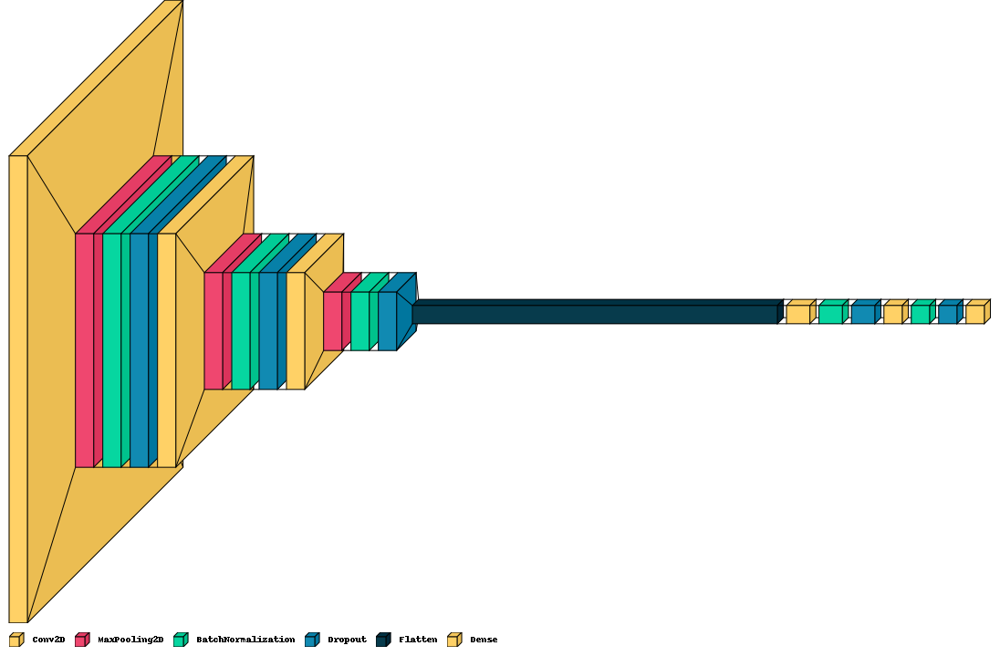

Epoch 1/9


2023-05-15 09:51:32.918496: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


226/226 [==============================] - ETA: 0s - loss: 0.6657 - accuracy: 0.6892
Epoch 1: val_loss improved from inf to 0.75981, saving model to cnn3l_model_weights_2:1:1.h5
226/226 [==============================] - 35s 154ms/step - loss: 0.6657 - accuracy: 0.6892 - val_loss: 0.7598 - val_accuracy: 0.5225 - lr: 0.0010
Epoch 2/9
226/226 [==============================] - ETA: 0s - loss: 0.5807 - accuracy: 0.7183
Epoch 2: val_loss improved from 0.75981 to 0.68951, saving model to cnn3l_model_weights_2:1:1.h5
226/226 [==============================] - 36s 161ms/step - loss: 0.5807 - accuracy: 0.7183 - val_loss: 0.6895 - val_accuracy: 0.5917 - lr: 0.0010
Epoch 3/9
226/226 [==============================] - ETA: 0s - loss: 0.5540 - accuracy: 0.7283
Epoch 3: val_loss improved from 0.68951 to 0.56145, saving model to cnn3l_model_weights_2:1:1.h5
226/226 [==============================] - 35s 155ms/step - loss: 0.5540 - accuracy: 0.7283 - val_loss: 0.5615 - val_accuracy: 0.7104 - lr: 0.00

In [83]:
#create CNNImageClassifier instance which is a derived class of ImageClassifier
cnn_base_classifier3CL = CNNImageClassifier3CL("CNN Base Classifier 3 Convolution Layers - Data balanced in ratio 2:1:1",
                                                 'cnn3l_model_weights_2:1:1.h5',
                                                 X_train_balanced, y_train_balanced, 
                                                 X_val_balanced, y_val_balanced)
_train_classifier(cnn_base_classifier3CL)

### Evaluate the model with the following - 3 Convolution Layers:
    1. Training and Validation loss against epocs
    2. Training and Validation accuracy against epocs
    3. Compute and display Testing accuracy, Precision, Recall, f1 score and rocauc
    4. Display classification report 
    5. Display confusion matrix
    6. Display ROC AUC curve

In [84]:
#load the best saved model
cnn_base_classifier3CL.load_saved_model()

75/75 [==============================] - 3s 38ms/step


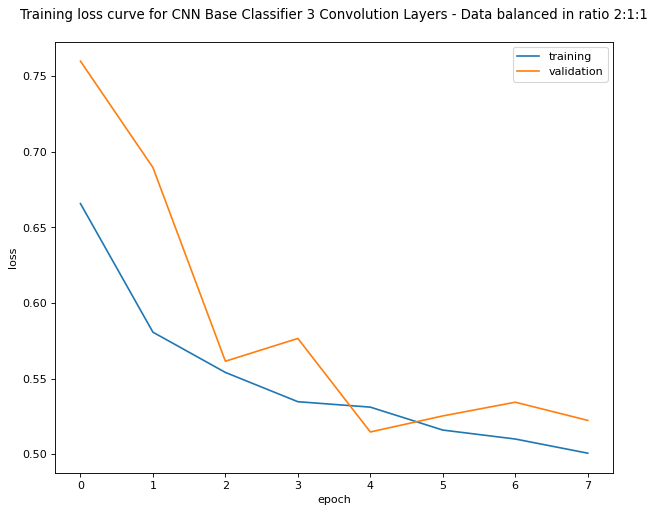

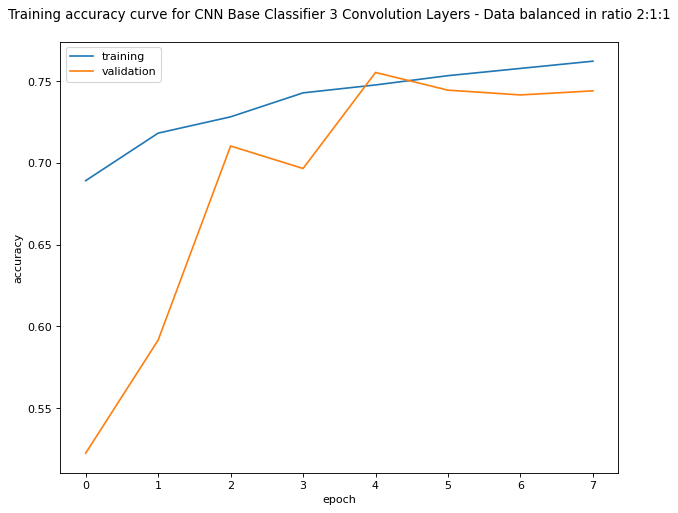

Metrics for CNN Base Classifier 3 Convolution Layers - Data balanced in ratio 2:1:1:

Testing Accuracy = 0.7491666666666666

Precision score = 0.7211538461538461

Recall score = 0.8125

F1 score = 0.7641065830721002

ROC AUC = 0.7491666666666665

              precision    recall  f1-score   support

           0       0.79      0.69      0.73      1200
           1       0.72      0.81      0.76      1200

    accuracy                           0.75      2400
   macro avg       0.75      0.75      0.75      2400
weighted avg       0.75      0.75      0.75      2400



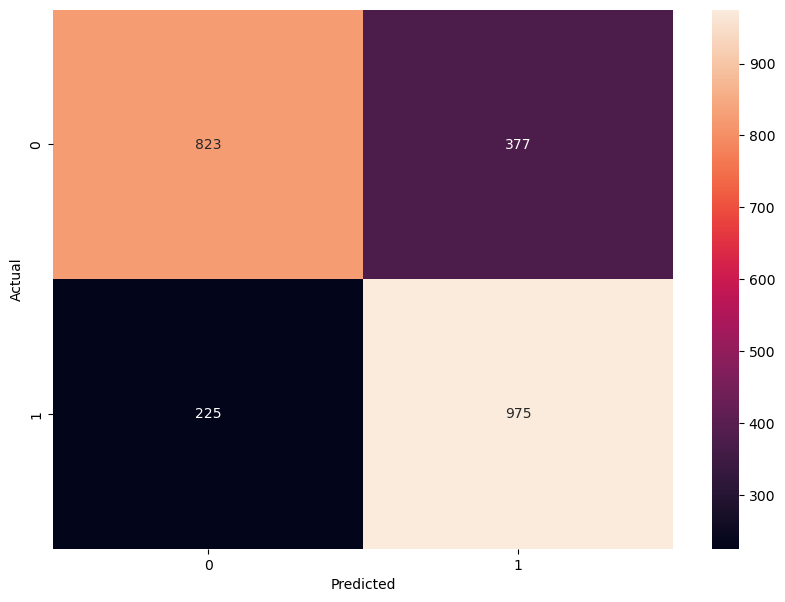

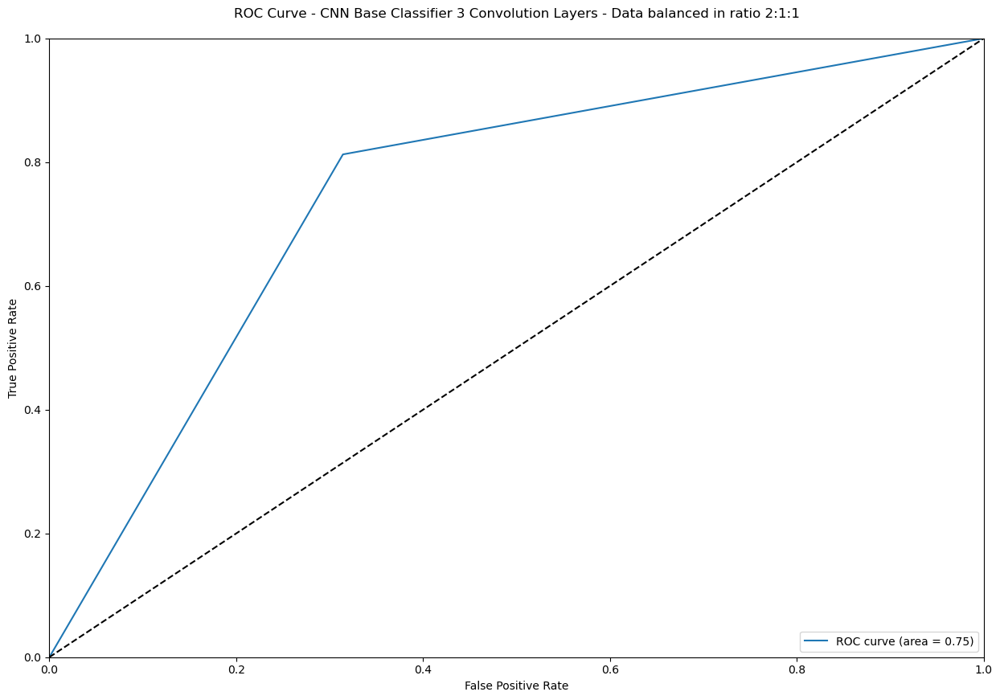

In [85]:
_test_classifier(cnn_base_classifier3CL, X_test_balanced, y_test_balanced)

In [86]:
#CNNImageClassifier derives from ImageClassifier
class CNNImageClassifier5CL(ImageClassifier):
    def __init__(self, name, weight_file_name, X_train, y_train, X_val, y_val):
        super().__init__(name, X_train, y_train, X_val, y_val)
        
        self.model_weights_name = weight_file_name
        self.num_epochs = 11
        self.batch_size = 32
        self.checkpoint = ModelCheckpoint(self.model_weights_name, monitor='val_loss',
                                          verbose=1, save_best_only=True, mode='min')
    
    def create_model(self):
        cnn = Sequential()
        #input and first convolution layer
        cnn.add(Conv2D(32, (3, 3), activation="relu", padding='same', 
                       input_shape=(self.train_X.shape[1], self.train_X.shape[2], self.train_X.shape[3])))
        cnn.add(MaxPooling2D(pool_size = (2, 2)))
        cnn.add(BatchNormalization())
        #cnn.add(Dropout(0.4))
        
        #convolution layer - 2
        cnn.add(Conv2D(64, (3, 3), activation="relu", padding='same'))
        cnn.add(MaxPooling2D(pool_size = (2, 2)))
        cnn.add(BatchNormalization())
        #cnn.add(Dropout(0.4))
        
        #convolution layer - 3
        cnn.add(Conv2D(64, (3, 3), activation="relu", padding='same'))
        cnn.add(MaxPooling2D(pool_size = (2, 2)))
        cnn.add(BatchNormalization())
        #cnn.add(Dropout(0.4))
        
        #convolution layer - 4
        cnn.add(Conv2D(128, (3, 3), activation="relu", padding='same'))
        cnn.add(MaxPooling2D(pool_size = (2, 2)))
        cnn.add(BatchNormalization())
        #cnn.add(Dropout(0.4))
        
        #convolution layer - 5
        cnn.add(Conv2D(128, (3, 3), activation="relu", padding='same'))
        cnn.add(MaxPooling2D(pool_size = (2, 2)))
        cnn.add(BatchNormalization())
        #cnn.add(Dropout(0.4))
        
        #flatten
        cnn.add(Flatten())
        
        #hidden layer - 1
        cnn.add(Dense(activation = 'relu', units = 128))
        cnn.add(BatchNormalization())
        cnn.add(Dropout(0.4))
        
        #hidden layer - 2
        cnn.add(Dense(activation = 'relu', units = 64))
        cnn.add(BatchNormalization())
        cnn.add(Dropout(0.4))
        #Final output layer with softmax activation
        #cnn.add(Dense(units = self.train_y.shape[1], activation = 'softmax'))
        cnn.add(Dense(activation = 'sigmoid', units = 1))
        # Compile model
        opt = optimizers.Adam(lr=1e-3)
        cnn.compile(optimizer = opt, loss = 'binary_crossentropy', metrics = ['accuracy'])
        
        self.model = cnn
               

### Create Model, visualize the same, train and observe the history - 5 Convolution Layers | Class 2:1:1

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 128, 128, 32)      320       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 64, 64, 32)       0         
 2D)                                                             
                                                                 
 batch_normalization_5 (Batc  (None, 64, 64, 32)       128       
 hNormalization)                                                 
                                                                 
 conv2d_4 (Conv2D)           (None, 64, 64, 64)        18496     
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 32, 32, 64)       0         
 2D)                                                             
                                                      

<span style='color:None'>None</span>

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


None

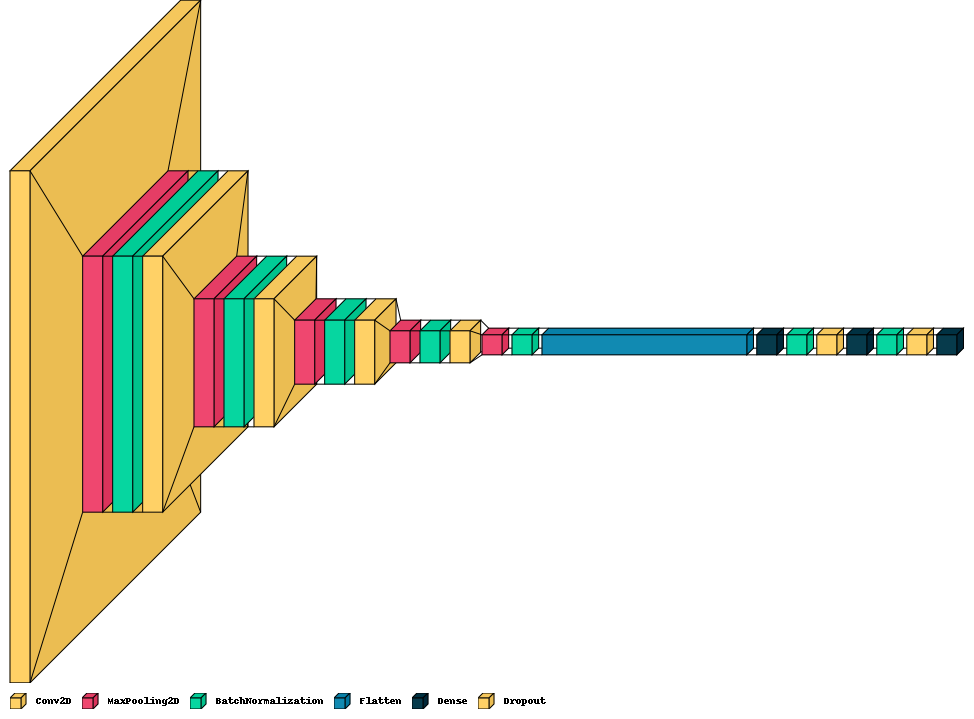

Epoch 1/11
226/226 [==============================] - ETA: 0s - loss: 0.6543 - accuracy: 0.6856
Epoch 1: val_loss improved from inf to 0.71540, saving model to cnn5l_model_weights_211.h5
226/226 [==============================] - 36s 158ms/step - loss: 0.6543 - accuracy: 0.6856 - val_loss: 0.7154 - val_accuracy: 0.5242 - lr: 0.0010
Epoch 2/11
226/226 [==============================] - ETA: 0s - loss: 0.5613 - accuracy: 0.7262
Epoch 2: val_loss improved from 0.71540 to 0.65812, saving model to cnn5l_model_weights_211.h5
226/226 [==============================] - 34s 149ms/step - loss: 0.5613 - accuracy: 0.7262 - val_loss: 0.6581 - val_accuracy: 0.6483 - lr: 0.0010
Epoch 3/11
226/226 [==============================] - ETA: 0s - loss: 0.5349 - accuracy: 0.7481
Epoch 3: val_loss improved from 0.65812 to 0.54998, saving model to cnn5l_model_weights_211.h5
226/226 [==============================] - 35s 156ms/step - loss: 0.5349 - accuracy: 0.7481 - val_loss: 0.5500 - val_accuracy: 0.7129 - l

In [87]:
#create CNNImageClassifier instance which is a derived class of ImageClassifier
cnn_base_classifier5CL = CNNImageClassifier5CL("CNN Base Classifier 5 Convolution Layers - Data balanced in ratio 2:1:1",
                                               'cnn5l_model_weights_211.h5',
                                                 X_train_balanced, y_train_balanced, 
                                                 X_val_balanced, y_val_balanced)
_train_classifier(cnn_base_classifier5CL)

In [88]:
#load the best saved model
cnn_base_classifier5CL.load_saved_model()

75/75 [==============================] - 5s 60ms/step


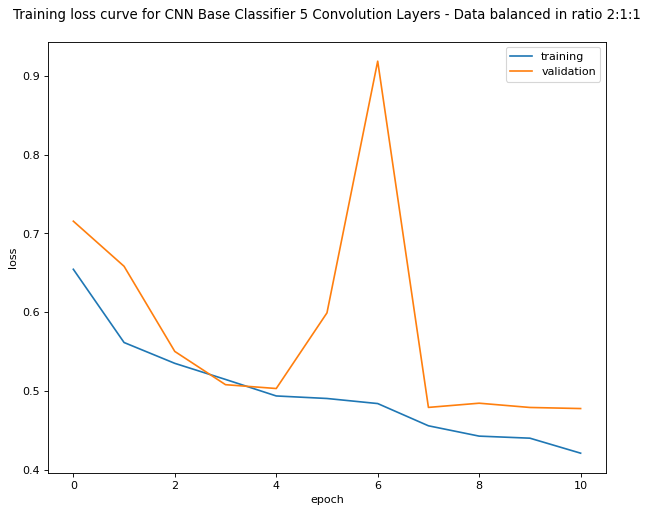

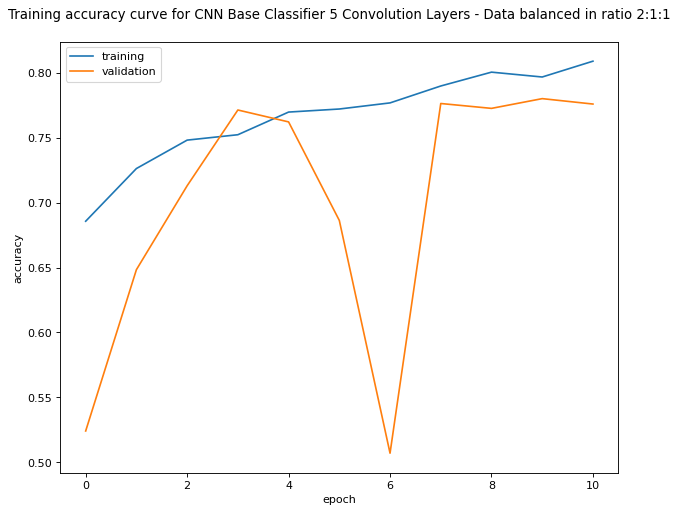

Metrics for CNN Base Classifier 5 Convolution Layers - Data balanced in ratio 2:1:1:

Testing Accuracy = 0.77875

Precision score = 0.7652656621728786

Recall score = 0.8041666666666667

F1 score = 0.7842340511986998

ROC AUC = 0.77875

              precision    recall  f1-score   support

           0       0.79      0.75      0.77      1200
           1       0.77      0.80      0.78      1200

    accuracy                           0.78      2400
   macro avg       0.78      0.78      0.78      2400
weighted avg       0.78      0.78      0.78      2400



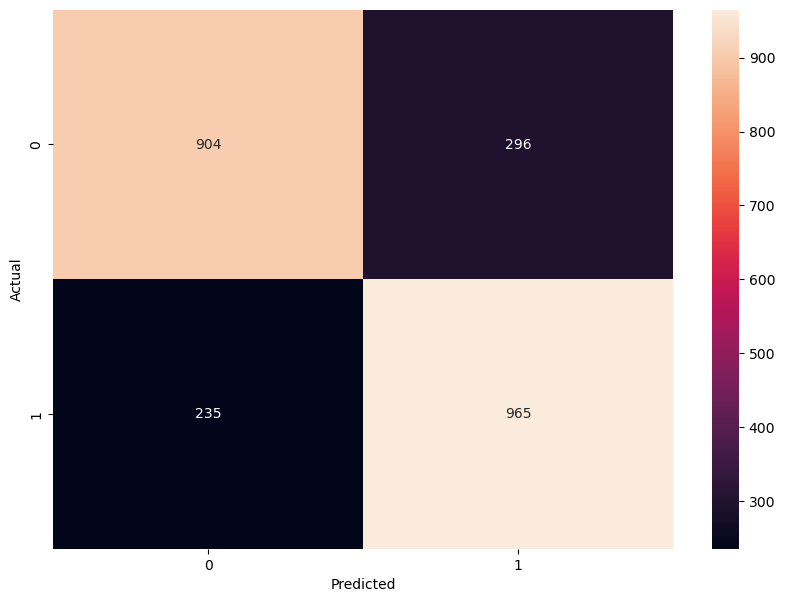

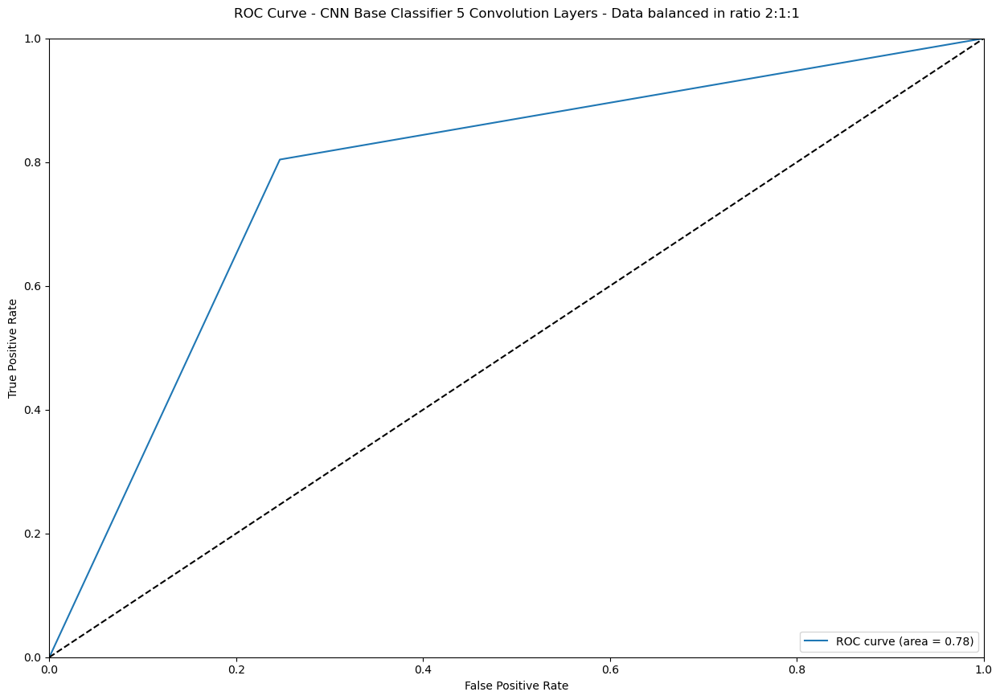

In [89]:
_test_classifier(cnn_base_classifier5CL, X_test_balanced, y_test_balanced)

## Target Ratio 1:1

'Lung Opacity' cases will occupy 50% forming Target 1. 'Normal' and 'No Lung Opacity | Not Normal' will add upto 50% forming Target 0. Further 'Normal' and 'No Lung Opacity | Not Normal' **will NOT be in equal propotions.**


In [90]:
def _get_target_balanced_data():
        df_pruned = pneumonia_data.df_merged_dicom_drop_duplicates
        
        X = df_pruned.drop('Target', axis=1)
        y = df_pruned['Target']
        rus = RandomUnderSampler()
        X_resampled, y_resampled = rus.fit_resample(X, y)
        
        X_train, X_val, y_train, y_val = get_train_test(X_resampled, y_resampled, test_size=0.4)
        X_val, X_test, y_val, y_test = get_train_test(X_val, y_val, test_size=0.5)
        
        return X_train, y_train, X_val, y_val, X_test, y_test
        
X_train_bt, y_train_bt, X_val_bt, y_val_bt, X_test_bt, y_test_bt = _get_target_balanced_data()

In [91]:
display_shapes(X_train_bt, y_train_bt, X_val_bt, y_val_bt, X_test_bt, y_test_bt)

X_train shape = (7214, 13)

y_train shape = (7214,)

X_val shape   = (2405, 13)

y_val shape   = (2405,)

X_test shape  = (2405, 13)

y_test shape  = (2405,)



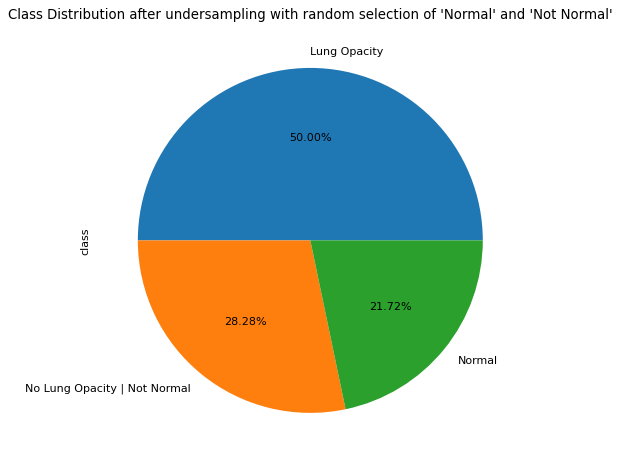

In [92]:
edatools.plot_piechart("Class Distribution after undersampling with random selection of 'Normal' and 'Not Normal'", X_train_bt, 
                       'class')

In [93]:
X_train_bt, y_train_bt, X_val_bt, y_val_bt, X_test_bt, y_test_bt = get_normalize_image_labels(X_train_bt, y_train_bt, X_val_bt, y_val_bt, X_test_bt, y_test_bt)

In [94]:
display_nparray_value_counts("y_train_bt", y_train_bt)
display_nparray_value_counts("y_val_bt", y_val_bt)
display_nparray_value_counts("y_test_bt", y_test_bt)

y_train_bt unique values = (array([0, 1]), array([3607, 3607]))

y_val_bt unique values = (array([0, 1]), array([1202, 1203]))

y_test_bt unique values = (array([0, 1]), array([1203, 1202]))



### Create Model, visualize the same, train and observe the history - 5 Convolution Layers | Target 1:1

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_8 (Conv2D)           (None, 128, 128, 32)      320       
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 64, 64, 32)       0         
 2D)                                                             
                                                                 
 batch_normalization_12 (Bat  (None, 64, 64, 32)       128       
 chNormalization)                                                
                                                                 
 conv2d_9 (Conv2D)           (None, 64, 64, 64)        18496     
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 32, 32, 64)       0         
 2D)                                                             
                                                      

<span style='color:None'>None</span>

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


None

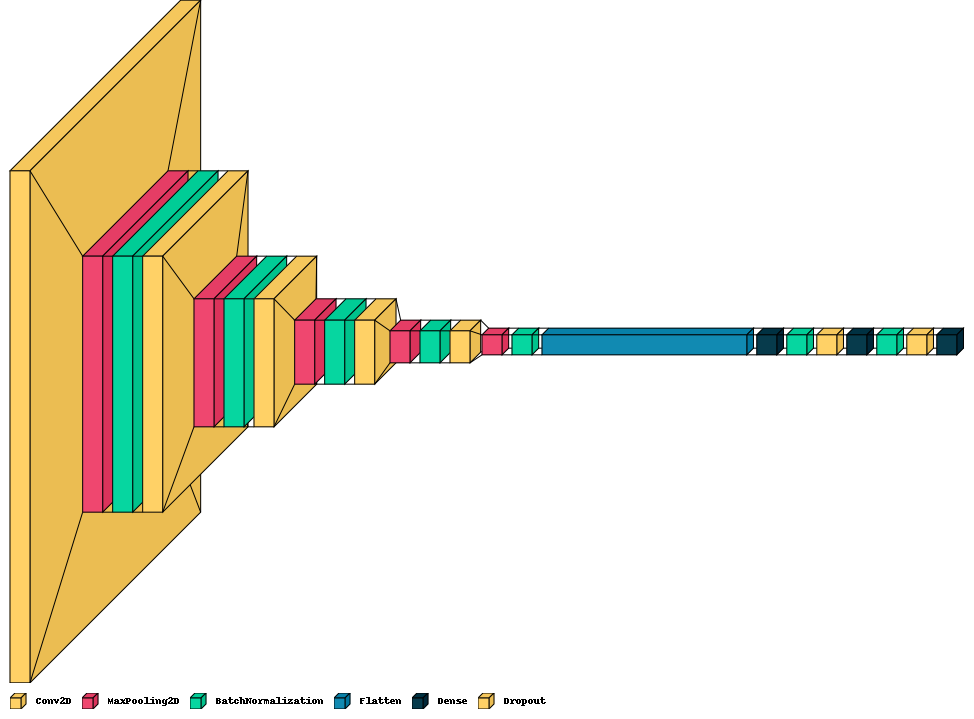

Epoch 1/11
226/226 [==============================] - ETA: 0s - loss: 0.6502 - accuracy: 0.6780
Epoch 1: val_loss improved from inf to 0.68352, saving model to cnn5l_model_weights_11.h5
226/226 [==============================] - 56s 245ms/step - loss: 0.6502 - accuracy: 0.6780 - val_loss: 0.6835 - val_accuracy: 0.5143 - lr: 0.0010
Epoch 2/11
226/226 [==============================] - ETA: 0s - loss: 0.5802 - accuracy: 0.7151
Epoch 2: val_loss did not improve from 0.68352
226/226 [==============================] - 55s 245ms/step - loss: 0.5802 - accuracy: 0.7151 - val_loss: 0.6899 - val_accuracy: 0.6067 - lr: 0.0010
Epoch 3/11
226/226 [==============================] - ETA: 0s - loss: 0.5480 - accuracy: 0.7354
Epoch 3: val_loss improved from 0.68352 to 0.55078, saving model to cnn5l_model_weights_11.h5
226/226 [==============================] - 58s 254ms/step - loss: 0.5480 - accuracy: 0.7354 - val_loss: 0.5508 - val_accuracy: 0.7235 - lr: 0.0010
Epoch 4/11
226/226 [====================

In [95]:
#create CNNImageClassifier instance which is a derived class of ImageClassifier
cnn_base_classifier5CL_bt = CNNImageClassifier5CL("CNN Base Classifier 5 Convolution Layers - Target Balanced with Random selection of 'Normal' and 'Not Normal'",
                                                 'cnn5l_model_weights_11.h5',
                                                 X_train_bt, y_train_bt, 
                                                 X_val_bt, y_val_bt)
_train_classifier(cnn_base_classifier5CL_bt)

76/76 [==============================] - 4s 53ms/step


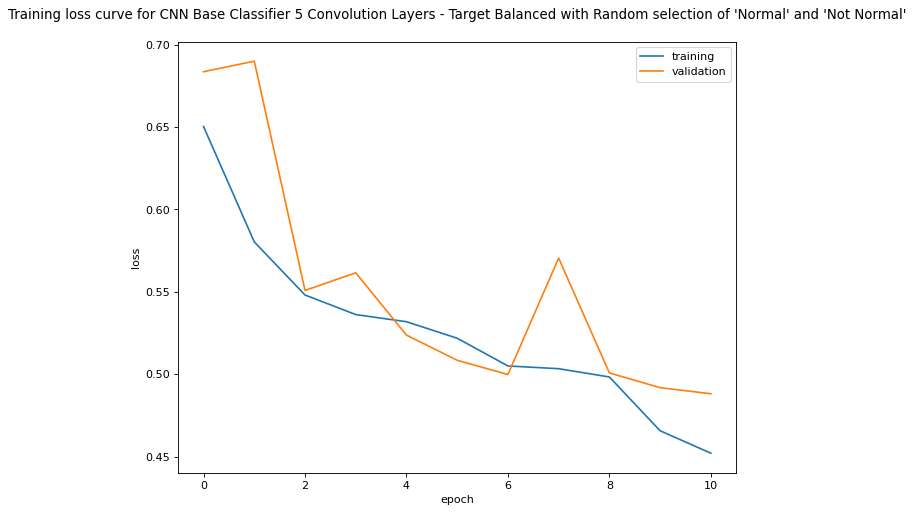

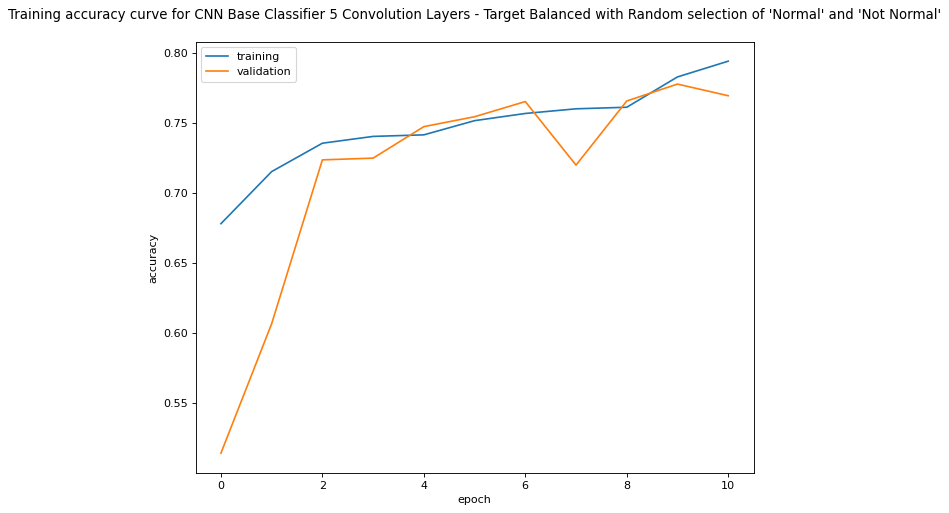

Metrics for CNN Base Classifier 5 Convolution Layers - Target Balanced with Random selection of 'Normal' and 'Not Normal':

Testing Accuracy = 0.7505197505197505

Precision score = 0.7516722408026756

Recall score = 0.7479201331114809

F1 score = 0.749791492910759

ROC AUC = 0.7505186700470122

              precision    recall  f1-score   support

           0       0.75      0.75      0.75      1203
           1       0.75      0.75      0.75      1202

    accuracy                           0.75      2405
   macro avg       0.75      0.75      0.75      2405
weighted avg       0.75      0.75      0.75      2405



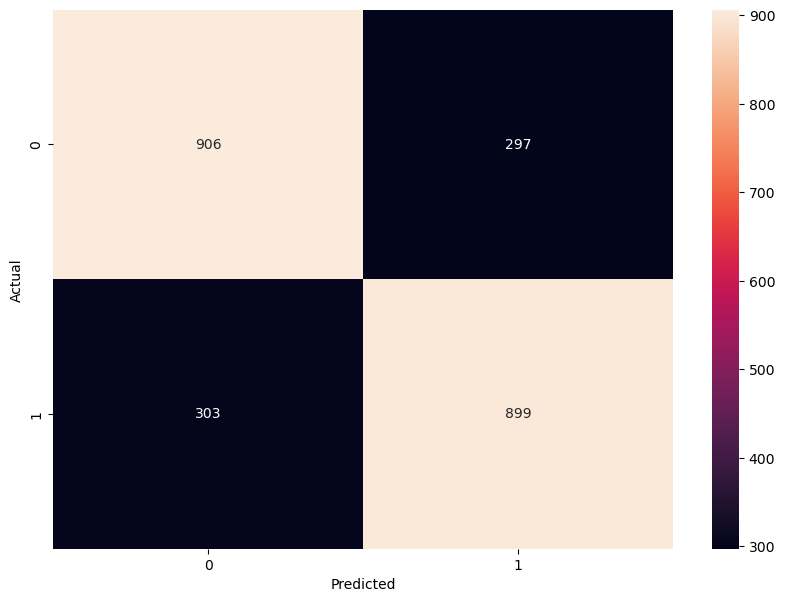

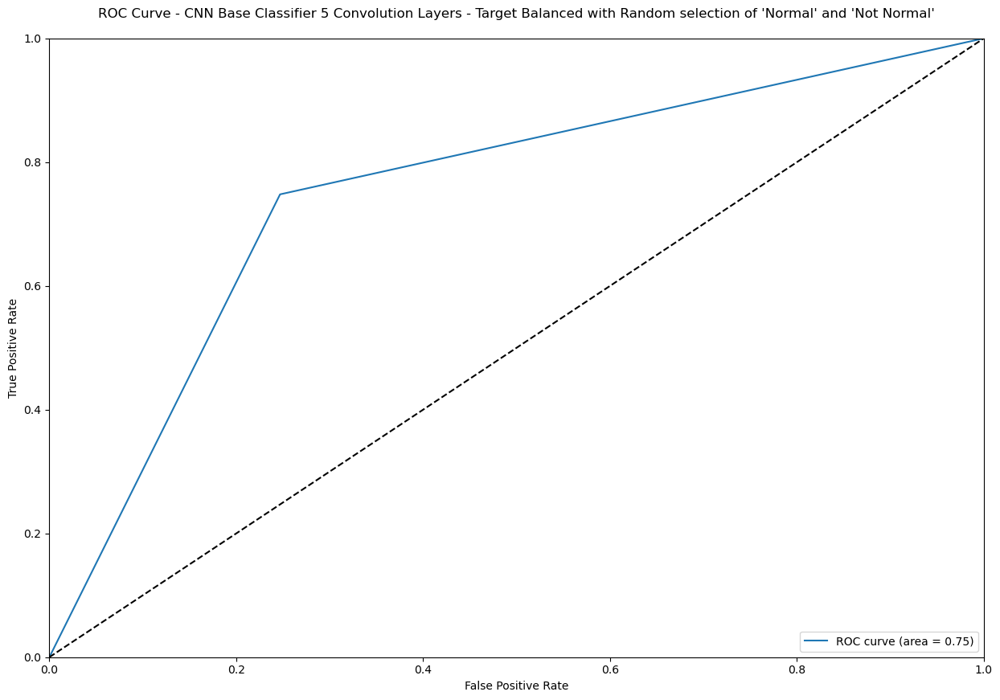

In [96]:
#load the best saved model
cnn_base_classifier5CL_bt.load_saved_model()
_test_classifier(cnn_base_classifier5CL_bt, X_test_bt, y_test_bt)

### Compare results

In [97]:
def _get_comparative_metrics():
    models = [cnn_base_classifier3CL, cnn_base_classifier5CL, cnn_base_classifier5CL_bt]
    model_names = ["CNN - 3 Conv layers | Class distribution 2:1:1", 
                   "CNN - 5 Conv layers | Class distribution 2:1:1", 
                   "CNN - 5 Conv layers | Target Distribution 1:1"]
    testing_accuracy = []
    precision = []
    recall = []
    f1 = []
    rocauc = []
    
    for model in models:
        testing_accuracy.append(model.metrics['testing_accuracy'])
        precision.append(model.metrics['precision'])
        recall.append(model.metrics['recall'])
        f1.append(model.metrics['f1'])
        rocauc.append(model.metrics['roc_auc'])
        
    col_names = ['name', 'testing acuracy', 'precision', 'recall', 'f1', 'rocauc']
    data = {'name': model_names, 'testing acuracy': testing_accuracy, 'precision': precision, 'name': model_names, 'recall': recall, 'f1': f1, 'rocauc': rocauc}

    df = pd.DataFrame(data, columns=col_names)
    
    return df
        
    
        

In [98]:
_get_comparative_metrics().round(2)

,name,testing acuracy,precision,recall,f1,rocauc
0,CNN - 3 Conv layers | Class distribution 2:1:1,0.75,0.72,0.81,0.76,0.75
1,CNN - 5 Conv layers | Class distribution 2:1:1,0.78,0.77,0.80,0.78,0.78
2,CNN - 5 Conv layers | Target Distribution 1:1,0.75,0.75,0.75,0.75,0.75
